##### Copyright 2019 The TensorFlow Authors.

In [ ]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Time series forecasting

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tutorials/structured_data/time_series"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/structured_data/time_series.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/docs/blob/master/site/en/tutorials/structured_data/time_series.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/docs/site/en/tutorials/structured_data/time_series.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

This tutorial is an introduction to time series forecasting using TensorFlow. It builds a few different styles of models including Convolutional and Recurrent Neural Networks (CNNs and RNNs).

This is covered in two main parts, with subsections: 

* Forecast for a single time step:
  * A single feature.
  * All features.
* Forecast multiple steps:
  * Single-shot: Make the predictions all at once.
  * Autoregressive: Make one prediction at a time and feed the output back to the model.

## Setup

In [1]:
import os
import datetime

import IPython
import IPython.display
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf

mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

## The weather dataset

This tutorial uses a <a href="https://www.bgc-jena.mpg.de/wetter/" class="external">weather time series dataset</a> recorded by the <a href="https://www.bgc-jena.mpg.de" class="external">Max Planck Institute for Biogeochemistry</a>.

This dataset contains 14 different features such as air temperature, atmospheric pressure, and humidity. These were collected every 10 minutes, beginning in 2003. For efficiency, you will use only the data collected between 2009 and 2016. This section of the dataset was prepared by François Chollet for his book <a href="https://www.manning.com/books/deep-learning-with-python" class="external">Deep Learning with Python</a>.

In [2]:
zip_path = tf.keras.utils.get_file(
    origin='https://storage.googleapis.com/tensorflow/tf-keras-datasets/jena_climate_2009_2016.csv.zip',
    fname='jena_climate_2009_2016.csv.zip',
    extract=True)
csv_path, _ = os.path.splitext(zip_path)

13582336/13568290 [==============================] - 1s 0us/step


This tutorial will just deal with **hourly predictions**, so start by sub-sampling the data from 10-minute intervals to one-hour intervals:

In [6]:
raw_df = pd.read_csv(csv_path)
raw_df.head()

,Date Time,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
0,01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.3,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.3
1,01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.4,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.1
2,01.01.2009 00:30:00,996.53,-8.51,264.91,-9.31,93.9,3.21,3.01,0.20,1.88,3.02,1310.24,0.19,0.63,171.6
3,01.01.2009 00:40:00,996.51,-8.31,265.12,-9.07,94.2,3.26,3.07,0.19,1.92,3.08,1309.19,0.34,0.50,198.0
4,01.01.2009 00:50:00,996.51,-8.27,265.15,-9.04,94.1,3.27,3.08,0.19,1.92,3.09,1309.00,0.32,0.63,214.3


In [3]:
df = pd.read_csv(csv_path)
# Slice [start:stop:step], starting from index 5 take every 6th record.
df = df[5::6]

date_time = pd.to_datetime(df.pop('Date Time'), format='%d.%m.%Y %H:%M:%S')

In [4]:
date_time

5        2009-01-01 01:00:00
11       2009-01-01 02:00:00
17       2009-01-01 03:00:00
23       2009-01-01 04:00:00
29       2009-01-01 05:00:00
                 ...        
420521   2016-12-31 19:10:00
420527   2016-12-31 20:10:00
420533   2016-12-31 21:10:00
420539   2016-12-31 22:10:00
420545   2016-12-31 23:10:00
Name: Date Time, Length: 70091, dtype: datetime64[ns]

Let's take a glance at the data. Here are the first few rows:

In [7]:
df.head()

,p (mbar),T (degC),Tpot (K),Tdew (degC),rh (%),VPmax (mbar),VPact (mbar),VPdef (mbar),sh (g/kg),H2OC (mmol/mol),rho (g/m**3),wv (m/s),max. wv (m/s),wd (deg)
5,996.50,-8.05,265.38,-8.78,94.4,3.33,3.14,0.19,1.96,3.15,1307.86,0.21,0.63,192.7
11,996.62,-8.88,264.54,-9.77,93.2,3.12,2.90,0.21,1.81,2.91,1312.25,0.25,0.63,190.3
17,996.84,-8.81,264.59,-9.66,93.5,3.13,2.93,0.20,1.83,2.94,1312.18,0.18,0.63,167.2
23,996.99,-9.05,264.34,-10.02,92.6,3.07,2.85,0.23,1.78,2.85,1313.61,0.10,0.38,240.0
29,997.46,-9.63,263.72,-10.65,92.2,2.94,2.71,0.23,1.69,2.71,1317.19,0.40,0.88,157.0


Here is the evolution of a few features over time:

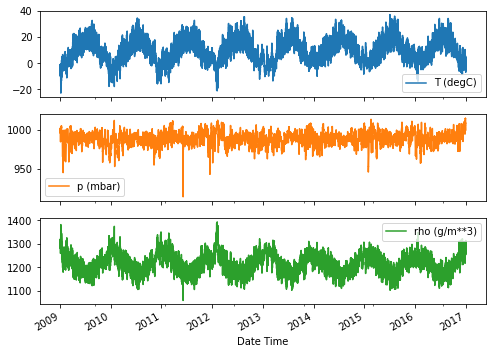

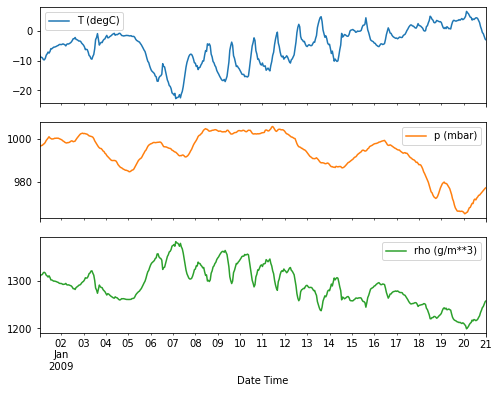

In [8]:
plot_cols = ['T (degC)', 'p (mbar)', 'rho (g/m**3)']
plot_features = df[plot_cols]
plot_features.index = date_time
_ = plot_features.plot(subplots=True)

plot_features = df[plot_cols][:480]
plot_features.index = date_time[:480]
_ = plot_features.plot(subplots=True)

### Inspect and cleanup

Next, look at the statistics of the dataset:

In [9]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
p (mbar),70091.0,989.212842,8.358886,913.60,984.20,989.57,994.720,1015.29
T (degC),70091.0,9.450482,8.423384,-22.76,3.35,9.41,15.480,37.28
Tpot (K),70091.0,283.493086,8.504424,250.85,277.44,283.46,289.530,311.21
Tdew (degC),70091.0,4.956471,6.730081,-24.80,0.24,5.21,10.080,23.06
rh (%),70091.0,76.009788,16.474920,13.88,65.21,79.30,89.400,100.00
VPmax (mbar),70091.0,13.576576,7.739883,0.97,7.77,11.82,17.610,63.77
VPact (mbar),70091.0,9.533968,4.183658,0.81,6.22,8.86,12.360,28.25
VPdef (mbar),70091.0,4.042536,4.898549,0.00,0.87,2.19,5.300,46.01
sh (g/kg),70091.0,6.022560,2.655812,0.51,3.92,5.59,7.800,18.07
H2OC (mmol/mol),70091.0,9.640437,4.234862,0.81,6.29,8.96,12.490,28.74


#### Wind velocity

One thing that should stand out is the `min` value of the wind velocity (`wv (m/s)`) and the maximum value (`max. wv (m/s)`) columns. This `-9999` is likely erroneous.

There's a separate wind direction column, so the velocity should be greater than zero (`>=0`). Replace it with zeros:

In [11]:
wv = df['wv (m/s)']
bad_wv = wv == -9999.0
wv[bad_wv] = 0.0

max_wv = df['max. wv (m/s)']
bad_max_wv = max_wv == -9999.0
max_wv[bad_max_wv] = 0.0

# The above inplace edits are reflected in the DataFrame.
df['wv (m/s)'].min()

0.0

### Feature engineering

Before diving in to build a model, it's important to understand your data and be sure that you're passing the model appropriately formatted data.

#### Wind
The last column of the data, `wd (deg)`—gives the wind direction in units of degrees. Angles do not make good model inputs: 360° and 0° should be close to each other and wrap around smoothly. Direction shouldn't matter if the wind is not blowing.

Right now the distribution of wind data looks like this:

Text(0, 0.5, 'Wind Velocity [m/s]')

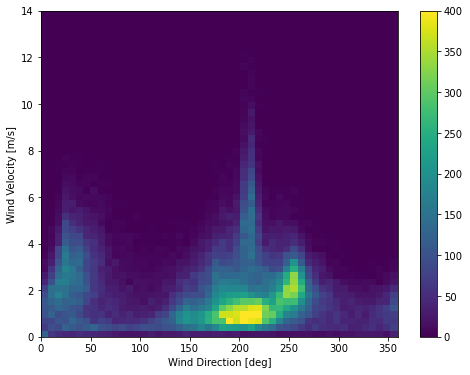

In [12]:
plt.hist2d(df['wd (deg)'], df['wv (m/s)'], bins=(50, 50), vmax=400)
plt.colorbar()
plt.xlabel('Wind Direction [deg]')
plt.ylabel('Wind Velocity [m/s]')

But this will be easier for the model to interpret if you convert the wind direction and velocity columns to a wind **vector**:

In [13]:
wv = df.pop('wv (m/s)')
max_wv = df.pop('max. wv (m/s)')

# Convert to radians.
wd_rad = df.pop('wd (deg)')*np.pi / 180

# Calculate the wind x and y components.
df['Wx'] = wv*np.cos(wd_rad)
df['Wy'] = wv*np.sin(wd_rad)

# Calculate the max wind x and y components.
df['max Wx'] = max_wv*np.cos(wd_rad)
df['max Wy'] = max_wv*np.sin(wd_rad)

The distribution of wind vectors is much simpler for the model to correctly interpret:

(-11.305513973134667, 8.24469928549079, -8.27438540335515, 7.7338312955467785)

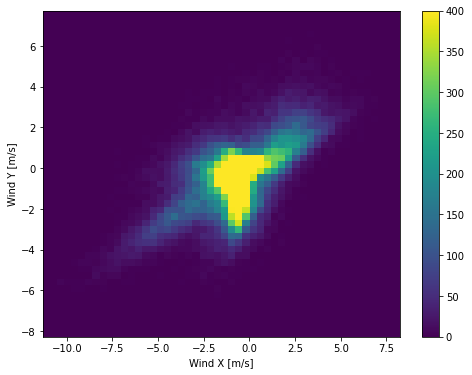

In [14]:
plt.hist2d(df['Wx'], df['Wy'], bins=(50, 50), vmax=400)
plt.colorbar()
plt.xlabel('Wind X [m/s]')
plt.ylabel('Wind Y [m/s]')
ax = plt.gca()
ax.axis('tight')

#### Time

Similarly, the `Date Time` column is very useful, but not in this string form. Start by converting it to seconds:

In [15]:
timestamp_s = date_time.map(pd.Timestamp.timestamp)

Similar to the wind direction, the time in seconds is not a useful model input. Being weather data, it has clear daily and yearly periodicity. There are many ways you could deal with periodicity.

You can get usable signals by using sine and cosine transforms to clear "Time of day" and "Time of year" signals:

In [16]:
timestamp_s

5         1.230772e+09
11        1.230775e+09
17        1.230779e+09
23        1.230782e+09
29        1.230786e+09
              ...     
420521    1.483211e+09
420527    1.483215e+09
420533    1.483219e+09
420539    1.483222e+09
420545    1.483226e+09
Name: Date Time, Length: 70091, dtype: float64

In [17]:
day = 24*60*60
year = (365.2425)*day

df['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
df['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
df['Year sin'] = np.sin(timestamp_s * (2 * np.pi / year))
df['Year cos'] = np.cos(timestamp_s * (2 * np.pi / year))

Text(0.5, 1.0, 'Time of day signal')

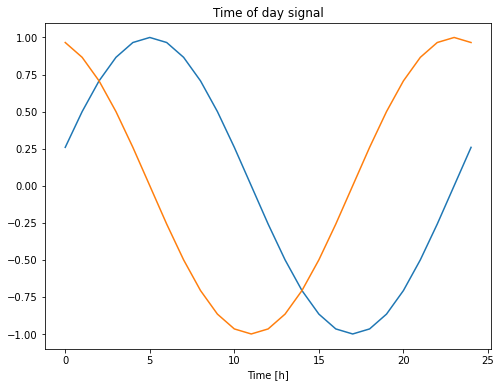

In [18]:
plt.plot(np.array(df['Day sin'])[:25])
plt.plot(np.array(df['Day cos'])[:25])
plt.xlabel('Time [h]')
plt.title('Time of day signal')

This gives the model access to the most important frequency features. In this case you knew ahead of time which frequencies were important. 

If you don't have that information, you can determine which frequencies are important by extracting features with <a href="https://en.wikipedia.org/wiki/Fast_Fourier_transform" class="external">Fast Fourier Transform</a>. To check the assumptions, here is the `tf.signal.rfft` of the temperature over time. Note the obvious peaks at frequencies near `1/year` and `1/day`:


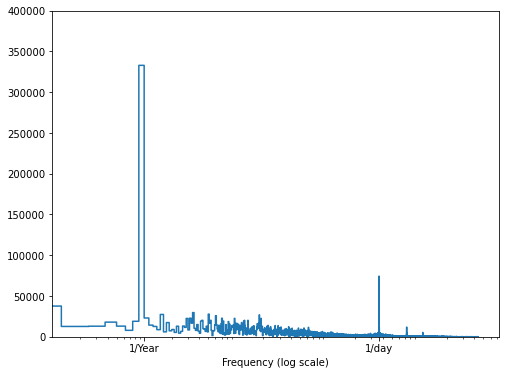

In [19]:
fft = tf.signal.rfft(df['T (degC)'])
f_per_dataset = np.arange(0, len(fft))

n_samples_h = len(df['T (degC)'])
hours_per_year = 24*365.2524
years_per_dataset = n_samples_h/(hours_per_year)

f_per_year = f_per_dataset/years_per_dataset
plt.step(f_per_year, np.abs(fft))
plt.xscale('log')
plt.ylim(0, 400000)
plt.xlim([0.1, max(plt.xlim())])
plt.xticks([1, 365.2524], labels=['1/Year', '1/day'])
_ = plt.xlabel('Frequency (log scale)')

### Split the data

You'll use a `(70%, 20%, 10%)` split for the training, validation, and test sets. Note the data is **not** being randomly shuffled before splitting. This is for two reasons:

1. It ensures that chopping the data into windows of consecutive samples is still possible.
2. It ensures that the validation/test results are more realistic, being evaluated on the data collected after the model was trained.

In [20]:
column_indices = {name: i for i, name in enumerate(df.columns)}

n = len(df)
train_df = df[0:int(n*0.7)]
val_df = df[int(n*0.7):int(n*0.9)]
test_df = df[int(n*0.9):]

num_features = df.shape[1]

### Normalize the data

It is important to scale features before training a neural network. Normalization is a common way of doing this scaling: subtract the mean and divide by the standard deviation of each feature.

The mean and standard deviation should only be computed using the training data so that the models have no access to the values in the validation and test sets.

It's also arguable that the model shouldn't have access to future values in the training set when training, and that this normalization should be done using moving averages. That's not the focus of this tutorial, and the validation and test sets ensure that you get (somewhat) honest metrics. So, in the interest of simplicity this tutorial uses a simple average.

In [21]:
train_mean = train_df.mean()
train_std = train_df.std()

train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std
test_df = (test_df - train_mean) / train_std

Now, peek at the distribution of the features. Some features do have long tails, but there are no obvious errors like the `-9999` wind velocity value.

In [23]:
df_std

,Column,Normalized
0,p (mbar),0.945308
1,p (mbar),0.959770
2,p (mbar),0.986284
3,p (mbar),1.004362
4,p (mbar),1.061006
...,...,...
1331724,Year cos,1.428472
1331725,Year cos,1.428464
1331726,Year cos,1.428456
1331727,Year cos,1.428447


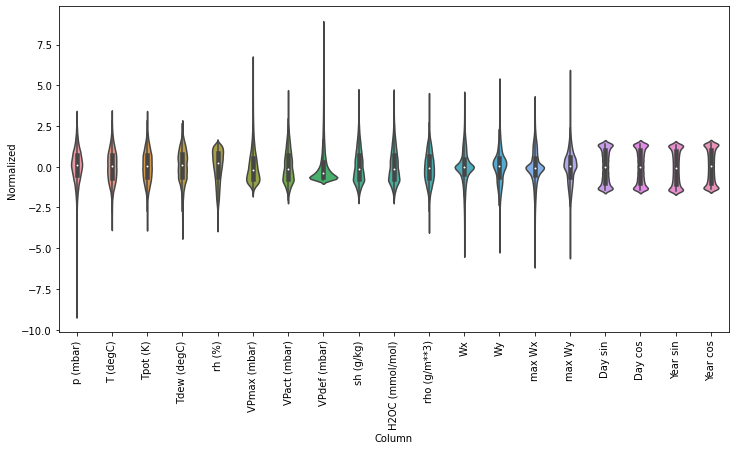

In [22]:
df_std = (df - train_mean) / train_std
df_std = df_std.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(df.keys(), rotation=90)

## Data windowing

The models in this tutorial will make a set of predictions based on a window of consecutive samples from the data. 

The main features of the input windows are:

- The width (number of time steps) of the input and label windows.
- The time offset between them.
- Which features are used as inputs, labels, or both. 

This tutorial builds a variety of models (including Linear, DNN, CNN and RNN models), and uses them for both:

- *Single-output*, and *multi-output* predictions.
- *Single-time-step* and *multi-time-step* predictions.

This section focuses on implementing the data windowing so that it can be reused for all of those models.


Depending on the task and type of model you may want to generate a variety of data windows. Here are some examples:

1. For example, to make a single prediction 24 hours into the future, given 24 hours of history, you might define a window like this:

  ![One prediction 24 hours into the future.](images/raw_window_24h.png)

2. A model that makes a prediction one hour into the future, given six hours of history, would need a window like this:

  ![One prediction one hour into the future.](images/raw_window_1h.png)

The rest of this section defines a `WindowGenerator` class. This class can:

1. Handle the indexes and offsets as shown in the diagrams above.
1. Split windows of features into `(features, labels)` pairs.
2. Plot the content of the resulting windows.
3. Efficiently generate batches of these windows from the training, evaluation, and test data, using `tf.data.Dataset`s.

### 1. Indexes and offsets

Start by creating the `WindowGenerator` class. The `__init__` method includes all the necessary logic for the input and label indices.

It also takes the training, evaluation, and test DataFrames as input. These will be converted to `tf.data.Dataset`s of windows later.

In [24]:
class WindowGenerator():
  def __init__(self, input_width, label_width, shift,
               train_df=train_df, val_df=val_df, test_df=test_df,
               label_columns=None):
    # Store the raw data.
    self.train_df = train_df
    self.val_df = val_df
    self.test_df = test_df

    # Work out the label column indices.
    self.label_columns = label_columns
    if label_columns is not None:
      self.label_columns_indices = {name: i for i, name in
                                    enumerate(label_columns)}
    self.column_indices = {name: i for i, name in
                           enumerate(train_df.columns)}

    # Work out the window parameters.
    self.input_width = input_width
    self.label_width = label_width
    self.shift = shift

    self.total_window_size = input_width + shift

    self.input_slice = slice(0, input_width)
    self.input_indices = np.arange(self.total_window_size)[self.input_slice]

    self.label_start = self.total_window_size - self.label_width
    self.labels_slice = slice(self.label_start, None)
    self.label_indices = np.arange(self.total_window_size)[self.labels_slice]

  def __repr__(self):
    return '\n'.join([
        f'Total window size: {self.total_window_size}',
        f'Input indices: {self.input_indices}',
        f'Label indices: {self.label_indices}',
        f'Label column name(s): {self.label_columns}'])

Here is code to create the 2 windows shown in the diagrams at the start of this section:

In [27]:
w1 = WindowGenerator(input_width=24, label_width=1, shift=24,
                     label_columns=['T (degC)'])
w1

Total window size: 48
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
Label indices: [47]
Label column name(s): ['T (degC)']

In [28]:
# output label/dimension/column is only 'T (degC)'
w2 = WindowGenerator(input_width=6, label_width=1, shift=1,
                     label_columns=['T (degC)'])
w2

Total window size: 7
Input indices: [0 1 2 3 4 5]
Label indices: [6]
Label column name(s): ['T (degC)']

### 2. Split

Given a list of consecutive inputs, the `split_window` method will convert them to a window of inputs and a window of labels.

The example `w2` you define earlier will be split like this:

![The initial window is all consecutive samples, this splits it into an (inputs, labels) pairs](images/split_window.png)

This diagram doesn't show the `features` axis of the data, but this `split_window` function also handles the `label_columns` so it can be used for both the single output and multi-output examples.

In [29]:
def split_window(self, features):
  inputs = features[:, self.input_slice, :]
  labels = features[:, self.labels_slice, :]
  if self.label_columns is not None:
    labels = tf.stack(
        [labels[:, :, self.column_indices[name]] for name in self.label_columns],
        axis=-1)

  # Slicing doesn't preserve static shape information, so set the shapes
  # manually. This way the `tf.data.Datasets` are easier to inspect.
  inputs.set_shape([None, self.input_width, None])
  labels.set_shape([None, self.label_width, None])

  return inputs, labels

WindowGenerator.split_window = split_window

Try it out:

In [30]:
# Stack three slices, the length of the total window.
example_window = tf.stack([np.array(train_df[:w2.total_window_size]),
                           np.array(train_df[100:100+w2.total_window_size]),
                           np.array(train_df[200:200+w2.total_window_size])])

example_inputs, example_labels = w2.split_window(example_window)

print('All shapes are: (batch, time, features)')
print(f'Window shape: {example_window.shape}')
print(f'Inputs shape: {example_inputs.shape}')
print(f'Labels shape: {example_labels.shape}')

All shapes are: (batch, time, features)
Window shape: (3, 7, 19)
Inputs shape: (3, 6, 19)
Labels shape: (3, 1, 1)


In [32]:
example_window.shape

TensorShape([3, 7, 19])

Typically, data in TensorFlow is packed into arrays where the outermost index is across examples (the "batch" dimension). The middle indices are the "time" or "space" (width, height) dimension(s). The innermost indices are the features.

The code above took a batch of three 7-time step windows with 19 features at each time step. It splits them into a batch of 6-time step 19-feature inputs, and a 1-time step 1-feature label. The label only has one feature because the `WindowGenerator` was initialized with `label_columns=['T (degC)']`. Initially, this tutorial will build models that predict single output labels.

### 3. Plot

Here is a plot method that allows a simple visualization of the split window:

In [33]:
w2.example = example_inputs, example_labels

In [34]:
def plot(self, model=None, plot_col='T (degC)', max_subplots=3):
  inputs, labels = self.example
  plt.figure(figsize=(12, 8))
  plot_col_index = self.column_indices[plot_col]
  max_n = min(max_subplots, len(inputs))
  for n in range(max_n):
    plt.subplot(max_n, 1, n+1)
    plt.ylabel(f'{plot_col} [normed]')
    plt.plot(self.input_indices, inputs[n, :, plot_col_index],
             label='Inputs', marker='.', zorder=-10)

    if self.label_columns:
      label_col_index = self.label_columns_indices.get(plot_col, None)
    else:
      label_col_index = plot_col_index

    if label_col_index is None:
      continue

    plt.scatter(self.label_indices, labels[n, :, label_col_index],
                edgecolors='k', label='Labels', c='#2ca02c', s=64)
    if model is not None:
      predictions = model(inputs)
      plt.scatter(self.label_indices, predictions[n, :, label_col_index],
                  marker='X', edgecolors='k', label='Predictions',
                  c='#ff7f0e', s=64)

    if n == 0:
      plt.legend()

  plt.xlabel('Time [h]')

WindowGenerator.plot = plot

This plot aligns inputs, labels, and (later) predictions based on the time that the item refers to:

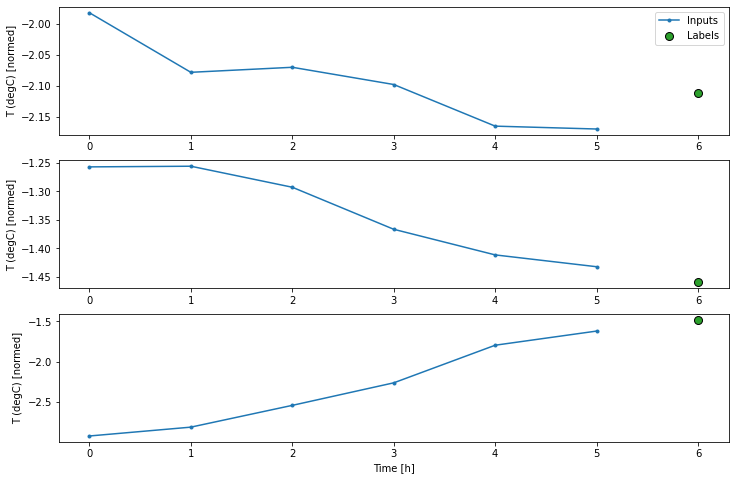

In [35]:
w2.plot()

You can plot the other columns, but the example window `w2` configuration only has labels for the `T (degC)` column.

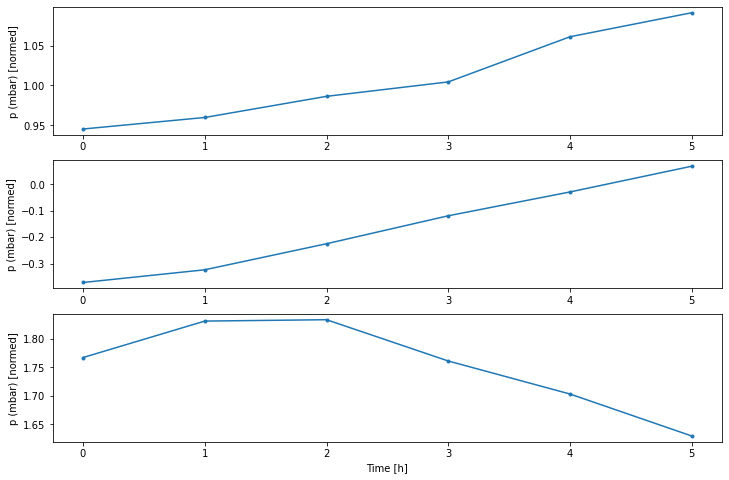

In [36]:
w2.plot(plot_col='p (mbar)')

### 4. Create `tf.data.Dataset`s

Finally, this `make_dataset` method will take a time series DataFrame and convert it to a `tf.data.Dataset` of `(input_window, label_window)` pairs using the `preprocessing.timeseries_dataset_from_array` function:

In [37]:
def make_dataset(self, data):
  data = np.array(data, dtype=np.float32)
  ds = tf.keras.preprocessing.timeseries_dataset_from_array(
      data=data,
      targets=None,
      sequence_length=self.total_window_size,
      sequence_stride=1,
      shuffle=True,
      batch_size=32,)

  ds = ds.map(self.split_window)

  return ds

WindowGenerator.make_dataset = make_dataset

The `WindowGenerator` object holds training, validation, and test data.

Add properties for accessing them as `tf.data.Dataset`s using the `make_dataset` method you defined earlier. Also, add a standard example batch for easy access and plotting:

In [38]:
@property
def train(self):
  return self.make_dataset(self.train_df)

@property
def val(self):
  return self.make_dataset(self.val_df)

@property
def test(self):
  return self.make_dataset(self.test_df)

@property
def example(self):
  """Get and cache an example batch of `inputs, labels` for plotting."""
  result = getattr(self, '_example', None)
  if result is None:
    # No example batch was found, so get one from the `.train` dataset
    result = next(iter(self.train))
    # And cache it for next time
    self._example = result
  return result

WindowGenerator.train = train
WindowGenerator.val = val
WindowGenerator.test = test
WindowGenerator.example = example

Now, the `WindowGenerator` object gives you access to the `tf.data.Dataset` objects, so you can easily iterate over the data.

The `Dataset.element_spec` property tells you the structure, data types, and shapes of the dataset elements.

In [39]:
# Each element is an (inputs, label) pair.
w2.train.element_spec

(TensorSpec(shape=(None, 6, 19), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 1, 1), dtype=tf.float32, name=None))

Iterating over a `Dataset` yields concrete batches:

In [40]:
for example_inputs, example_labels in w2.train.take(1):
  print(f'Inputs shape (batch, time, features): {example_inputs.shape}')
  print(f'Labels shape (batch, time, features): {example_labels.shape}')

Inputs shape (batch, time, features): (32, 6, 19)
Labels shape (batch, time, features): (32, 1, 1)


## Single step models

The simplest model you can build on this sort of data is one that predicts a single feature's value—1 time step (one hour) into the future based only on the current conditions.

So, start by building models to predict the `T (degC)` value one hour into the future.

![Predict the next time step](images/narrow_window.png)

Configure a `WindowGenerator` object to produce these single-step `(input, label)` pairs:

In [44]:
single_step_window = WindowGenerator(
    input_width=1, label_width=1, shift=1,
    label_columns=['T (degC)'])
single_step_window

Total window size: 2
Input indices: [0]
Label indices: [1]
Label column name(s): ['T (degC)']

The `window` object creates `tf.data.Dataset`s from the training, validation, and test sets, allowing you to easily iterate over batches of data.


In [45]:
for example_inputs, example_labels in single_step_window.train.take(1):
  print(f'Inputs shape (batch, time, features): {example_inputs.shape}')
  print(f'Labels shape (batch, time, features): {example_labels.shape}')

Inputs shape (batch, time, features): (32, 1, 19)
Labels shape (batch, time, features): (32, 1, 1)


### Baseline

Before building a trainable model it would be good to have a performance baseline as a point for comparison with the later more complicated models.

This first task is to predict temperature one hour into the future, given the current value of all features. The current values include the current temperature. 

So, start with a model that just returns the current temperature as the prediction, predicting "No change". This is a reasonable baseline since temperature changes slowly. Of course, this baseline will work less well if you make a prediction further in the future.

![Send the input to the output](images/baseline.png)

In [46]:
class Baseline(tf.keras.Model):
  def __init__(self, label_index=None):
    super().__init__()
    self.label_index = label_index

  def call(self, inputs):
    if self.label_index is None:
      return inputs
    result = inputs[:, :, self.label_index]
    return result[:, :, tf.newaxis]

Instantiate and evaluate this model:

In [47]:
baseline = Baseline(label_index=column_indices['T (degC)'])

baseline.compile(loss=tf.losses.MeanSquaredError(),
                 metrics=[tf.metrics.MeanAbsoluteError()])

val_performance = {}
performance = {}
val_performance['Baseline'] = baseline.evaluate(single_step_window.val)
performance['Baseline'] = baseline.evaluate(single_step_window.test, verbose=0)

439/439 [==============================] - 0s 769us/step - loss: 0.0128 - mean_absolute_error: 0.0785


That printed some performance metrics, but those don't give you a feeling for how well the model is doing.

The `WindowGenerator` has a plot method, but the plots won't be very interesting with only a single sample.

So, create a wider `WindowGenerator` that generates windows 24 hours of consecutive inputs and labels at a time. The new `wide_window` variable doesn't change the way the model operates. The model still makes predictions one hour into the future based on a single input time step. Here, the `time` axis acts like the `batch` axis: each prediction is made independently with no interaction between time steps:

In [48]:
wide_window = WindowGenerator(
    input_width=24, label_width=24, shift=1,
    label_columns=['T (degC)'])

wide_window

Total window size: 25
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
Label indices: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24]
Label column name(s): ['T (degC)']

This expanded window can be passed directly to the same `baseline` model without any code changes. This is possible because the inputs and labels have the same number of time steps, and the baseline just forwards the input to the output:

![One prediction 1h into the future, ever hour.](images/last_window.png)

In [49]:
print('Input shape:', wide_window.example[0].shape)
print('Output shape:', baseline(wide_window.example[0]).shape)

Input shape: (32, 24, 19)
Output shape: (32, 24, 1)


By plotting the baseline model's predictions, notice that it is simply the labels shifted right by one hour:

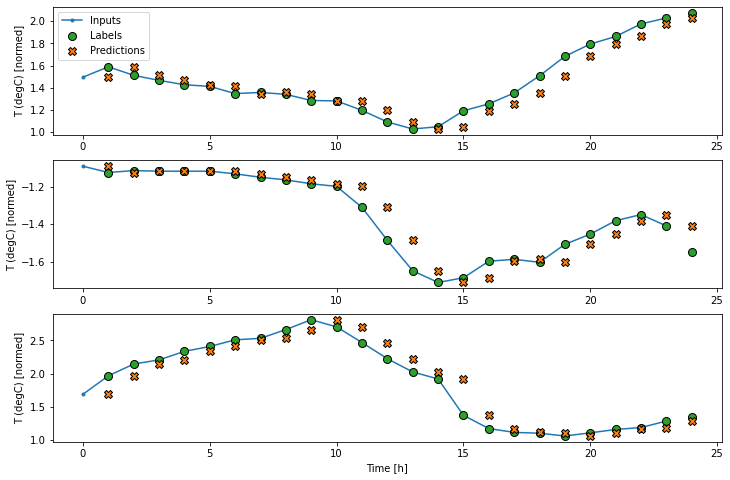

In [50]:
wide_window.plot(baseline)

In the above plots of three examples the single step model is run over the course of 24 hours. This deserves some explanation:

- The blue `Inputs` line shows the input temperature at each time step. The model receives all features, this plot only shows the temperature.
- The green `Labels` dots show the target prediction value. These dots are shown at the prediction time, not the input time. That is why the range of labels is shifted 1 step relative to the inputs.
- The orange `Predictions` crosses are the model's prediction's for each output time step. If the model were predicting perfectly the predictions would land directly on the `Labels`.

### Linear model

The simplest **trainable** model you can apply to this task is to insert linear transformation between the input and output. In this case the output from a time step only depends on that step:

![A single step prediction](images/narrow_window.png)

A `tf.keras.layers.Dense` layer with no `activation` set is a linear model. The layer only transforms the last axis of the data from `(batch, time, inputs)` to `(batch, time, units)`; it is applied independently to every item across the `batch` and `time` axes.

In [51]:
linear = tf.keras.Sequential([
    tf.keras.layers.Dense(units=1)
])

In [52]:
print('Input shape:', single_step_window.example[0].shape)
print('Output shape:', linear(single_step_window.example[0]).shape)

Input shape: (32, 1, 19)
Output shape: (32, 1, 1)


This tutorial trains many models, so package the training procedure into a function:

In [53]:
MAX_EPOCHS = 20

def compile_and_fit(model, window, patience=2):
  early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=patience,
                                                    mode='min')

  model.compile(loss=tf.losses.MeanSquaredError(),
                optimizer=tf.optimizers.Adam(),
                metrics=[tf.metrics.MeanAbsoluteError()])

  history = model.fit(window.train, epochs=MAX_EPOCHS,
                      validation_data=window.val,
                      callbacks=[early_stopping])
  return history

Train the model and evaluate its performance:

In [54]:
history = compile_and_fit(linear, single_step_window)

val_performance['Linear'] = linear.evaluate(single_step_window.val)
performance['Linear'] = linear.evaluate(single_step_window.test, verbose=0)

Epoch 1/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.1742 - mean_absolute_error: 0.2487 - val_loss: 0.0096 - val_mean_absolute_error: 0.0729
Epoch 2/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0096 - mean_absolute_error: 0.0719 - val_loss: 0.0089 - val_mean_absolute_error: 0.0692
Epoch 3/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0093 - mean_absolute_error: 0.0708 - val_loss: 0.0087 - val_mean_absolute_error: 0.0686
Epoch 4/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0093 - mean_absolute_error: 0.0705 - val_loss: 0.0088 - val_mean_absolute_error: 0.0688
Epoch 5/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0092 - mean_absolute_error: 0.0703 - val_loss: 0.0087 - val_mean_absolute_error: 0.0682
Epoch 6/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0092 - mean_absolute_error: 0.0702 - val_loss: 0.0086 - val_mean_absolute_error: 0.0683
Epoc

Like the `baseline` model, the linear model can be called on batches of wide windows. Used this way the model makes a set of independent predictions on consecutive time steps. The `time` axis acts like another `batch` axis. There are no interactions between the predictions at each time step.

![A single step prediction](images/wide_window.png)

In [55]:
print('Input shape:', wide_window.example[0].shape)
print('Output shape:', baseline(wide_window.example[0]).shape)

Input shape: (32, 24, 19)
Output shape: (32, 24, 1)


Here is the plot of its example predictions on the `wide_window`, note how in many cases the prediction is clearly better than just returning the input temperature, but in a few cases it's worse:

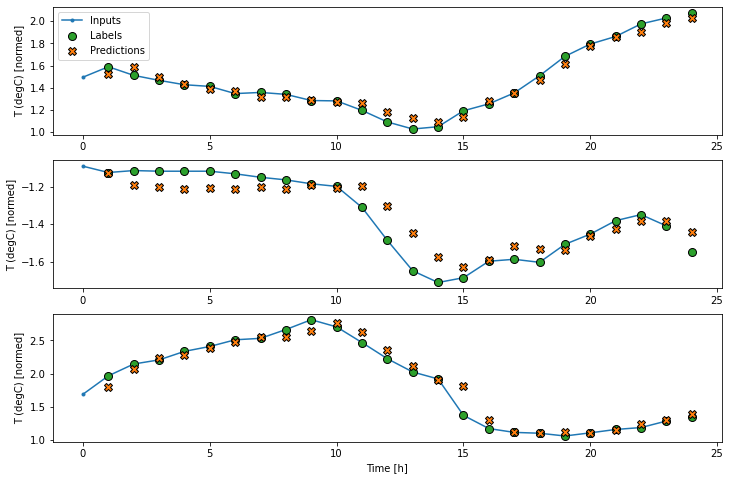

In [56]:
wide_window.plot(linear)

### Imp -
One advantage to linear models is that they're relatively simple to  interpret.
You can pull out the layer's weights and visualize the weight assigned to each input:

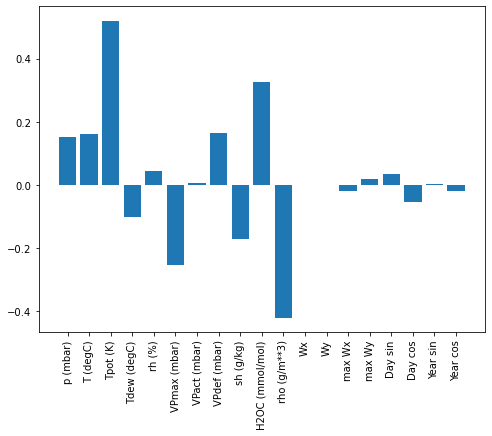

In [57]:
plt.bar(x = range(len(train_df.columns)),
        height=linear.layers[0].kernel[:,0].numpy())
axis = plt.gca()
axis.set_xticks(range(len(train_df.columns)))
_ = axis.set_xticklabels(train_df.columns, rotation=90)

Sometimes the model doesn't even place the most weight on the input `T (degC)`. This is one of the risks of random initialization. 

### Dense

Before applying models that actually operate on multiple time-steps, it's worth checking the performance of deeper, more powerful, single input step models.

Here's a model similar to the `linear` model, except it stacks several a few `Dense` layers between the input and the output: 

In [58]:
dense = tf.keras.Sequential([
    tf.keras.layers.Dense(units=64, activation='relu'),
    tf.keras.layers.Dense(units=64, activation='relu'),
    tf.keras.layers.Dense(units=1)
])

history = compile_and_fit(dense, single_step_window)

val_performance['Dense'] = dense.evaluate(single_step_window.val)
performance['Dense'] = dense.evaluate(single_step_window.test, verbose=0)

Epoch 1/20
1534/1534 [==============================] - 3s 2ms/step - loss: 0.0140 - mean_absolute_error: 0.0774 - val_loss: 0.0093 - val_mean_absolute_error: 0.0690
Epoch 2/20
1534/1534 [==============================] - 3s 2ms/step - loss: 0.0077 - mean_absolute_error: 0.0636 - val_loss: 0.0074 - val_mean_absolute_error: 0.0621
Epoch 3/20
1534/1534 [==============================] - 3s 2ms/step - loss: 0.0074 - mean_absolute_error: 0.0615 - val_loss: 0.0067 - val_mean_absolute_error: 0.0576
Epoch 4/20
1534/1534 [==============================] - 2s 1ms/step - loss: 0.0071 - mean_absolute_error: 0.0605 - val_loss: 0.0071 - val_mean_absolute_error: 0.0610
Epoch 5/20
439/439 [==============================] - 1s 1ms/step - loss: 0.0073 - mean_absolute_error: 0.0624


### Multi-step dense

A single-time-step model has no context for the current values of its inputs. It can't see how the input features are changing over time. To address this issue the model needs access to multiple time steps when making predictions:

![Three time steps are used for each prediction.](images/conv_window.png)


The `baseline`, `linear` and `dense` models handled each time step independently. Here the model will take multiple time steps as input to produce a single output.

Create a `WindowGenerator` that will produce batches of three-hour inputs and one-hour labels:

Note that the `Window`'s `shift` parameter is relative to the end of the two windows.


In [59]:
CONV_WIDTH = 3
conv_window = WindowGenerator(
    input_width=CONV_WIDTH,
    label_width=1,
    shift=1,
    label_columns=['T (degC)'])

conv_window

Total window size: 4
Input indices: [0 1 2]
Label indices: [3]
Label column name(s): ['T (degC)']

Text(0.5, 1.0, 'Given 3 hours of inputs, predict 1 hour into the future.')

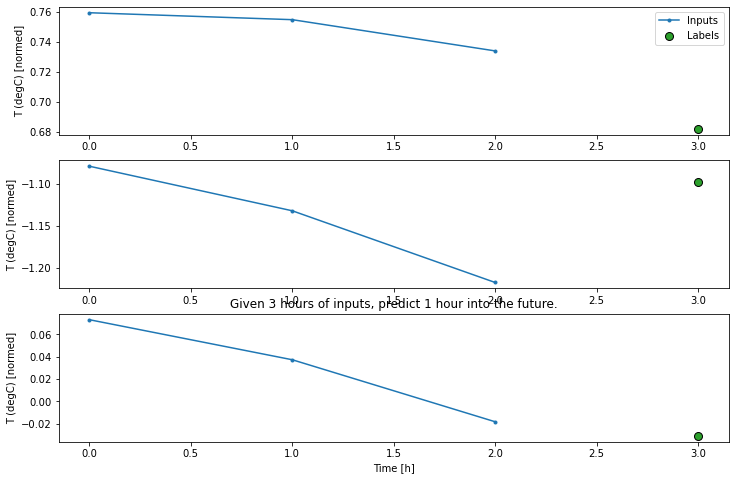

In [60]:
conv_window.plot()
plt.title("Given 3 hours of inputs, predict 1 hour into the future.")

You could train a `dense` model on a multiple-input-step window by adding a `tf.keras.layers.Flatten` as the first layer of the model:

In [61]:
multi_step_dense = tf.keras.Sequential([
    # Shape: (time, features) => (time*features)
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(units=32, activation='relu'),
    tf.keras.layers.Dense(units=32, activation='relu'),
    tf.keras.layers.Dense(units=1),
    # Add back the time dimension.
    # Shape: (outputs) => (1, outputs)
    tf.keras.layers.Reshape([1, -1]),
])

In [62]:
print('Input shape:', conv_window.example[0].shape)
print('Output shape:', multi_step_dense(conv_window.example[0]).shape)

Input shape: (32, 3, 19)
Output shape: (32, 1, 1)


In [63]:
history = compile_and_fit(multi_step_dense, conv_window)

IPython.display.clear_output()
val_performance['Multi step dense'] = multi_step_dense.evaluate(conv_window.val)
performance['Multi step dense'] = multi_step_dense.evaluate(conv_window.test, verbose=0)

438/438 [==============================] - 0s 680us/step - loss: 0.0066 - mean_absolute_error: 0.0561


In [80]:
multi_step_dense.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, None)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 32)                1856      
_________________________________________________________________
dense_5 (Dense)              (None, 32)                1056      
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 33        
_________________________________________________________________
reshape (Reshape)            (None, 1, 1)              0         
Total params: 2,945
Trainable params: 2,945
Non-trainable params: 0
_________________________________________________________________


In [84]:
(1856 - 32)/32

57.0

In [81]:
print(conv_window.example[0].shape)
wide_window.example[0].shape

(32, 3, 19)


TensorShape([32, 24, 19])

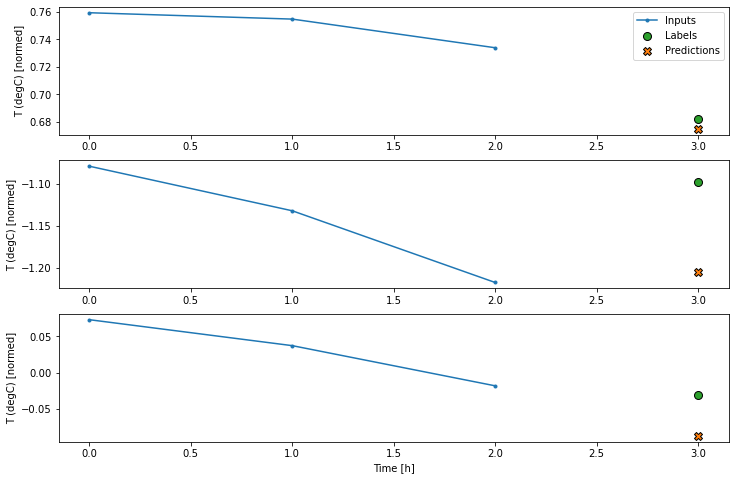

In [64]:
conv_window.plot(multi_step_dense)

The main down-side of this approach is that the resulting model can only be executed on input windows of exactly this shape. 

In [70]:
# trying to pass (32,24,19) instead of (32,3,19)
print('Input shape:', wide_window.example[0].shape)
try:
  print('Output shape:', multi_step_dense(wide_window.example[0]).shape)
except Exception as e:
  print(f'\n{type(e).__name__}:{e}')

Input shape: (32, 24, 19)

ValueError:Input 0 of layer dense_4 is incompatible with the layer: expected axis -1 of input shape to have value 57 but received input with shape (32, 456)


The convolutional models in the next section fix this problem.

### Convolution neural network
 
A convolution layer (`tf.keras.layers.Conv1D`) also takes multiple time steps as input to each prediction.

Below is the **same** model as `multi_step_dense`, re-written with a convolution. 

Note the changes:
* The `tf.keras.layers.Flatten` and the first `tf.keras.layers.Dense` are replaced by a `tf.keras.layers.Conv1D`.
* The `tf.keras.layers.Reshape` is no longer necessary since the convolution keeps the time axis in its output.

### @comments by me - 
A convolution Layer in Keras is an operation independent of the input size. The numebr of weights depends on the KERNEL_SIZE and the number of filters.

In [75]:
conv_model = tf.keras.Sequential([
    tf.keras.layers.Conv1D(filters=32,
                           kernel_size=(CONV_WIDTH,),
                           activation='relu'),
    tf.keras.layers.Dense(units=32, activation='relu'),
    tf.keras.layers.Dense(units=1),
])

Run it on an example batch to check that the model produces outputs with the expected shape:

In [77]:
print("Conv model on `conv_window`")
print('Input shape:', conv_window.example[0].shape)
print('Output shape:', conv_model(conv_window.example[0]).shape)

Conv model on `conv_window`
Input shape: (32, 3, 19)
Output shape: (32, 1, 1)


Train and evaluate it on the ` conv_window` and it should give performance similar to the `multi_step_dense` model.

In [78]:
history = compile_and_fit(conv_model, conv_window)

IPython.display.clear_output()
val_performance['Conv'] = conv_model.evaluate(conv_window.val)
performance['Conv'] = conv_model.evaluate(conv_window.test, verbose=0)

438/438 [==============================] - 0s 1ms/step - loss: 0.0064 - mean_absolute_error: 0.0565


In [79]:
conv_model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 1, 32)             1856      
_________________________________________________________________
dense_9 (Dense)              (None, 1, 32)             1056      
_________________________________________________________________
dense_10 (Dense)             (None, 1, 1)              33        
Total params: 2,945
Trainable params: 2,945
Non-trainable params: 0
_________________________________________________________________


The difference between this `conv_model` and the `multi_step_dense` model is that the `conv_model` can be run on inputs of any length. The convolutional layer is applied to a sliding window of inputs:

![Executing a convolutional model on a sequence](images/wide_conv_window.png)

If you run it on wider input, it produces wider output:

In [74]:
print("Wide window")
print('Input shape:', wide_window.example[0].shape)
print('Labels shape:', wide_window.example[1].shape)
print('Output shape:', conv_model(wide_window.example[0]).shape)

Wide window
Input shape: (32, 24, 19)
Labels shape: (32, 24, 1)
Output shape: (32, 22, 1)


Note that the output is shorter than the input. To make training or plotting work, you need the labels, and prediction to have the same length. So build a `WindowGenerator` to produce wide windows with a few extra input time steps so the label and prediction lengths match: 

In [85]:
LABEL_WIDTH = 24
INPUT_WIDTH = LABEL_WIDTH + (CONV_WIDTH - 1)
wide_conv_window = WindowGenerator(
    input_width=INPUT_WIDTH,
    label_width=LABEL_WIDTH,
    shift=1,
    label_columns=['T (degC)'])

wide_conv_window

Total window size: 27
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25]
Label indices: [ 3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26]
Label column name(s): ['T (degC)']

In [86]:
print("Wide conv window")
print('Input shape:', wide_conv_window.example[0].shape)
print('Labels shape:', wide_conv_window.example[1].shape)
print('Output shape:', conv_model(wide_conv_window.example[0]).shape)

Wide conv window
Input shape: (32, 26, 19)
Labels shape: (32, 24, 1)
Output shape: (32, 24, 1)


Now, you can plot the model's predictions on a wider window. Note the 3 input time steps before the first prediction. Every prediction here is based on the 3 preceding time steps:

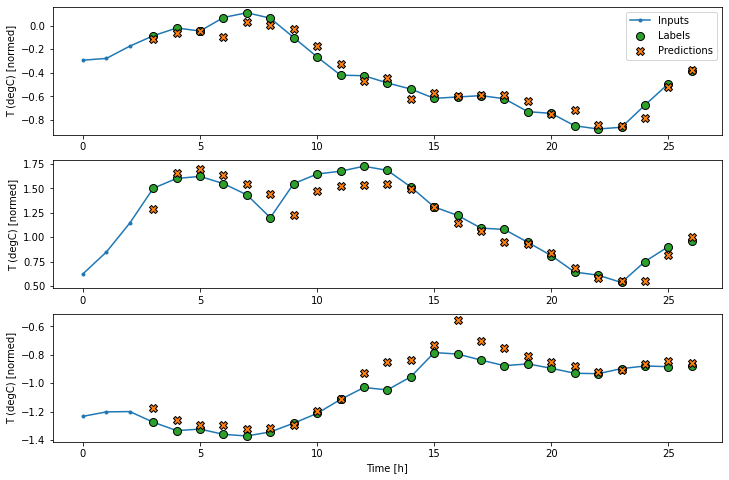

In [87]:
wide_conv_window.plot(conv_model)

### Recurrent neural network

A Recurrent Neural Network (RNN) is a type of neural network well-suited to time series data. RNNs process a time series step-by-step, maintaining an internal state from time-step to time-step.

You can learn more in the [Text generation with an RNN](https://www.tensorflow.org/text/tutorials/text_generation) tutorial and the [Recurrent Neural Networks (RNN) with Keras](https://www.tensorflow.org/guide/keras/rnn) guide.

In this tutorial, you will use an RNN layer called Long Short-Term Memory (`tf.keras.layers.LSTM`).

An important constructor argument for all Keras RNN layers, such as `tf.keras.layers.LSTM`, is the `return_sequences` argument. This setting can configure the layer in one of two ways:

1. If `False`, the default, the layer only returns the output of the final time step, giving the model time to warm up its internal state before making a single prediction: 

![An LSTM warming up and making a single prediction](images/lstm_1_window.png)

2. If `True`, the layer returns an output for each input. This is useful for:
  * Stacking RNN layers. 
  * Training a model on multiple time steps simultaneously.

![An LSTM making a prediction after every time step](images/lstm_many_window.png)

In [88]:
lstm_model = tf.keras.models.Sequential([
    # Shape [batch, time, features] => [batch, time, lstm_units]
    tf.keras.layers.LSTM(32, return_sequences=True),
    # Shape => [batch, time, features]
    tf.keras.layers.Dense(units=1)
])

With `return_sequences=True`, the model can be trained on 24 hours of data at a time.

Note: This will give a pessimistic view of the model's performance. On the first time step, the model has no access to previous steps and, therefore, can't do any better than the simple `linear` and `dense` models shown earlier.

In [89]:
print('Input shape:', wide_window.example[0].shape)
print('Output shape:', lstm_model(wide_window.example[0]).shape)

Input shape: (32, 24, 19)
Output shape: (32, 24, 1)


In [90]:
history = compile_and_fit(lstm_model, wide_window)

IPython.display.clear_output()
val_performance['LSTM'] = lstm_model.evaluate(wide_window.val)
performance['LSTM'] = lstm_model.evaluate(wide_window.test, verbose=0)

438/438 [==============================] - 1s 1ms/step - loss: 0.0057 - mean_absolute_error: 0.0519


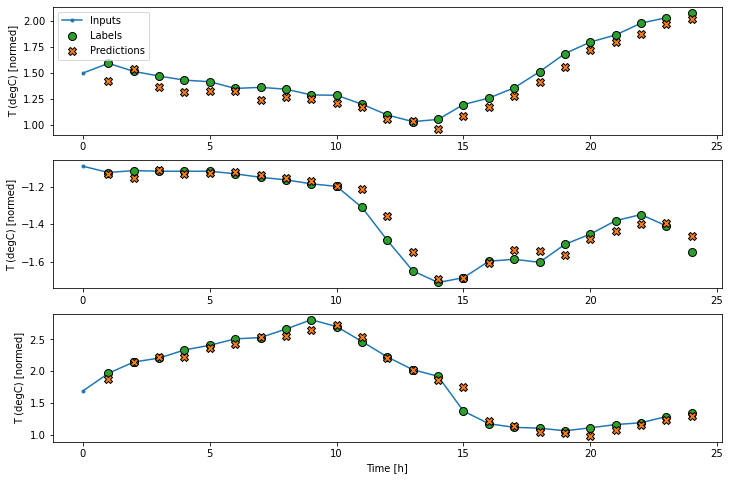

In [91]:
wide_window.plot(lstm_model)

### Performance

With this dataset typically each of the models does slightly better than the one before it:

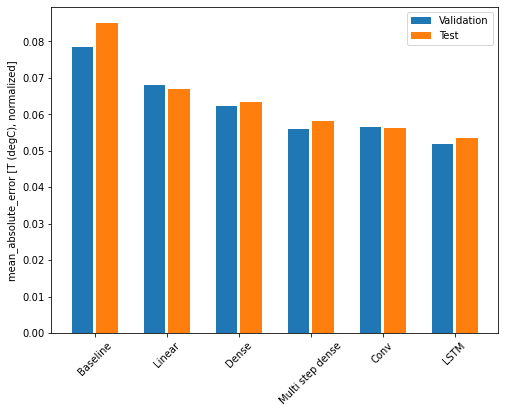

In [92]:
x = np.arange(len(performance))
width = 0.3
metric_name = 'mean_absolute_error'
metric_index = lstm_model.metrics_names.index('mean_absolute_error')
val_mae = [v[metric_index] for v in val_performance.values()]
test_mae = [v[metric_index] for v in performance.values()]

plt.ylabel('mean_absolute_error [T (degC), normalized]')
plt.bar(x - 0.17, val_mae, width, label='Validation')
plt.bar(x + 0.17, test_mae, width, label='Test')
plt.xticks(ticks=x, labels=performance.keys(),
           rotation=45)
_ = plt.legend()

In [93]:
for name, value in performance.items():
  print(f'{name:12s}: {value[1]:0.4f}')

Baseline    : 0.0852
Linear      : 0.0670
Dense       : 0.0633
Multi step dense: 0.0582
Conv        : 0.0562
LSTM        : 0.0537


### Multi-output models

The models so far all predicted a single output feature, `T (degC)`, for a single time step.

All of these models can be converted to predict multiple features just by changing the number of units in the output layer and adjusting the training windows to include all features in the `labels` (`example_labels`):

In [94]:
single_step_window = WindowGenerator(
    # `WindowGenerator` returns all features as labels if you 
    # don't set the `label_columns` argument.
    input_width=1, label_width=1, shift=1)

wide_window = WindowGenerator(
    input_width=24, label_width=24, shift=1)

for example_inputs, example_labels in wide_window.train.take(1):
  print(f'Inputs shape (batch, time, features): {example_inputs.shape}')
  print(f'Labels shape (batch, time, features): {example_labels.shape}')

Inputs shape (batch, time, features): (32, 24, 19)
Labels shape (batch, time, features): (32, 24, 19)


Note above that the `features` axis of the labels now has the same depth as the inputs, instead of `1`.

#### Baseline

The same baseline model (`Baseline`) can be used here, but this time repeating all features instead of selecting a specific `label_index`:

In [95]:
baseline = Baseline()
baseline.compile(loss=tf.losses.MeanSquaredError(),
                 metrics=[tf.metrics.MeanAbsoluteError()])

In [96]:
val_performance = {}
performance = {}
val_performance['Baseline'] = baseline.evaluate(wide_window.val)
performance['Baseline'] = baseline.evaluate(wide_window.test, verbose=0)

438/438 [==============================] - 0s 689us/step - loss: 0.0886 - mean_absolute_error: 0.1589


#### Dense

In [98]:
num_features

19

In [99]:
dense = tf.keras.Sequential([
    tf.keras.layers.Dense(units=64, activation='relu'),
    tf.keras.layers.Dense(units=64, activation='relu'),
    tf.keras.layers.Dense(units=num_features)
])

In [100]:
history = compile_and_fit(dense, single_step_window)

IPython.display.clear_output()
val_performance['Dense'] = dense.evaluate(single_step_window.val)
performance['Dense'] = dense.evaluate(single_step_window.test, verbose=0)

439/439 [==============================] - 1s 1ms/step - loss: 0.0680 - mean_absolute_error: 0.1300


#### RNN


In [101]:
%%time
wide_window = WindowGenerator(
    input_width=24, label_width=24, shift=1)

lstm_model = tf.keras.models.Sequential([
    # Shape [batch, time, features] => [batch, time, lstm_units]
    tf.keras.layers.LSTM(32, return_sequences=True),
    # Shape => [batch, time, features]
    tf.keras.layers.Dense(units=num_features)
])

history = compile_and_fit(lstm_model, wide_window)

IPython.display.clear_output()
val_performance['LSTM'] = lstm_model.evaluate( wide_window.val)
performance['LSTM'] = lstm_model.evaluate( wide_window.test, verbose=0)

print()

438/438 [==============================] - 1s 2ms/step - loss: 0.0614 - mean_absolute_error: 0.1204

CPU times: user 2min 43s, sys: 24.9 s, total: 3min 8s
Wall time: 1min 8s


<a id="residual"></a>

#### Advanced: Residual connections

The `Baseline` model from earlier took advantage of the fact that the sequence doesn't change drastically from time step to time step. Every model trained in this tutorial so far was randomly initialized, and then had to learn that the output is a a small change from the previous time step.

While you can get around this issue with careful initialization, it's  simpler to build this into the model structure.

It's common in time series analysis to build models that instead of predicting the next value, predict how the value will change in the next time step. Similarly, <a href="https://arxiv.org/abs/1512.03385" class="external">residual networks</a>—or ResNets—in deep learning refer to architectures where each layer adds to the model's accumulating result.

That is how you take advantage of the knowledge that the change should be small.

![A model with a residual connection](images/residual.png)

Essentially, this initializes the model to match the `Baseline`. For this task it helps models converge faster, with slightly better performance.

This approach can be used in conjunction with any model discussed in this tutorial. 

### Imp - 
Here, it is being applied to the LSTM model, note the use of the `tf.initializers.zeros` to ensure that the initial predicted changes are small, and don't overpower the residual connection. There are no symmetry-breaking concerns for the gradients here, since the `zeros` are only used on the last layer.

In [102]:
class ResidualWrapper(tf.keras.Model):
  def __init__(self, model):
    super().__init__()
    self.model = model

  def call(self, inputs, *args, **kwargs):
    delta = self.model(inputs, *args, **kwargs)

    # The prediction for each time step is the input
    # from the previous time step plus the delta
    # calculated by the model.
    return inputs + delta

In [103]:
%%time
residual_lstm = ResidualWrapper(
    tf.keras.Sequential([
    tf.keras.layers.LSTM(32, return_sequences=True),
    tf.keras.layers.Dense(
        num_features,
        # The predicted deltas should start small.
        # Therefore, initialize the output layer with zeros.
        kernel_initializer=tf.initializers.zeros())
]))

history = compile_and_fit(residual_lstm, wide_window)

IPython.display.clear_output()
val_performance['Residual LSTM'] = residual_lstm.evaluate(wide_window.val)
performance['Residual LSTM'] = residual_lstm.evaluate(wide_window.test, verbose=0)
print()

438/438 [==============================] - 1s 2ms/step - loss: 0.0619 - mean_absolute_error: 0.1182

CPU times: user 1min, sys: 9.59 s, total: 1min 10s
Wall time: 26.2 s


In [110]:
val_performance['Residual LSTM']
g1 = residual_lstm.predict( wide_window.val)
g1.shape

(13994, 24, 19)

#### Performance

Here is the overall performance for these multi-output models.

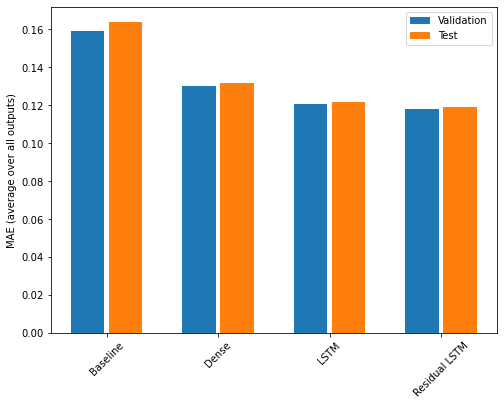

In [104]:
x = np.arange(len(performance))
width = 0.3

metric_name = 'mean_absolute_error'
metric_index = lstm_model.metrics_names.index('mean_absolute_error')
val_mae = [v[metric_index] for v in val_performance.values()]
test_mae = [v[metric_index] for v in performance.values()]

plt.bar(x - 0.17, val_mae, width, label='Validation')
plt.bar(x + 0.17, test_mae, width, label='Test')
plt.xticks(ticks=x, labels=performance.keys(),
           rotation=45)
plt.ylabel('MAE (average over all outputs)')
_ = plt.legend()

In [105]:
for name, value in performance.items():
  print(f'{name:15s}: {value[1]:0.4f}')

Baseline       : 0.1638
Dense          : 0.1320
LSTM           : 0.1216
Residual LSTM  : 0.1193


The above performances are averaged across all model outputs.

## Multi-step models

Both the single-output and multiple-output models in the previous sections made **single time step predictions**, one hour into the future.

This section looks at how to expand these models to make **multiple time step predictions**.

In a multi-step prediction, the model needs to learn to predict a range of future values. Thus, unlike a single step model, where only a single future point is predicted, a multi-step model predicts a sequence of the future values.

There are two rough approaches to this:

1. Single shot predictions where the entire time series is predicted at once.
2. Autoregressive predictions where the model only makes single step predictions and its output is fed back as its input.

In this section all the models will predict **all the features across all output time steps**.


For the multi-step model, the training data again consists of hourly samples. However, here, the models will learn to predict 24 hours into the future, given 24 hours of the past.

Here is a `Window` object that generates these slices from the dataset:

Total window size: 48
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
Label indices: [24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label column name(s): None

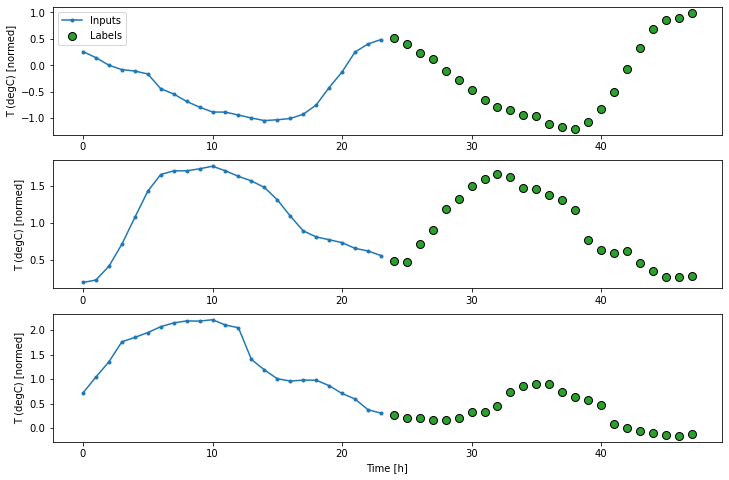

In [111]:
OUT_STEPS = 24
multi_window = WindowGenerator(input_width=24,
                               label_width=OUT_STEPS,
                               shift=OUT_STEPS)

multi_window.plot()
multi_window

### Baselines

A simple baseline for this task is to repeat the last input time step for the required number of output time steps:

![Repeat the last input, for each output step](images/multistep_last.png)

437/437 [==============================] - 0s 781us/step - loss: 0.6285 - mean_absolute_error: 0.5007


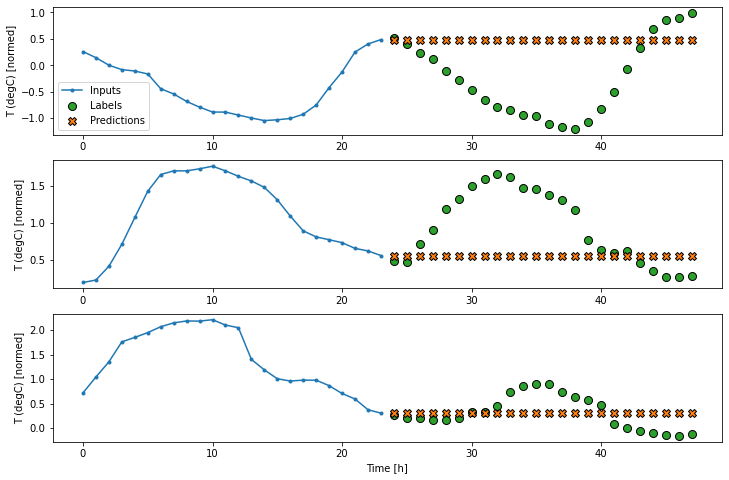

In [112]:
class MultiStepLastBaseline(tf.keras.Model):
  def call(self, inputs):
    return tf.tile(inputs[:, -1:, :], [1, OUT_STEPS, 1])

last_baseline = MultiStepLastBaseline()
last_baseline.compile(loss=tf.losses.MeanSquaredError(),
                      metrics=[tf.metrics.MeanAbsoluteError()])

multi_val_performance = {}
multi_performance = {}

multi_val_performance['Last'] = last_baseline.evaluate(multi_window.val)
multi_performance['Last'] = last_baseline.evaluate(multi_window.test, verbose=0)
multi_window.plot(last_baseline)

Since this task is to predict 24 hours into the future, given 24 hours of the past, another simple approach is to repeat the previous day, assuming tomorrow will be similar:

![Repeat the previous day](images/multistep_repeat.png)

In [ ]:
class RepeatBaseline(tf.keras.Model):
  def call(self, inputs):
    return inputs

repeat_baseline = RepeatBaseline()
repeat_baseline.compile(loss=tf.losses.MeanSquaredError(),
                        metrics=[tf.metrics.MeanAbsoluteError()])

multi_val_performance['Repeat'] = repeat_baseline.evaluate(multi_window.val)
multi_performance['Repeat'] = repeat_baseline.evaluate(multi_window.test, verbose=0)
multi_window.plot(repeat_baseline)

### Single-shot models

One high-level approach to this problem is to use a "single-shot" model, where the model makes the entire sequence prediction in a single step.

This can be implemented efficiently as a `tf.keras.layers.Dense` with `OUT_STEPS*features` output units. The model just needs to reshape that output to the required `(OUTPUT_STEPS, features)`.

#### Linear

A simple linear model based on the last input time step does better than either baseline, but is underpowered. The model needs to predict `OUTPUT_STEPS` time steps, from a single input time step with a linear projection. It can only capture a low-dimensional slice of the behavior, likely based mainly on the time of day and time of year.

![Predict all timesteps from the last time-step](images/multistep_dense.png)

437/437 [==============================] - 0s 1ms/step - loss: 0.2558 - mean_absolute_error: 0.3061


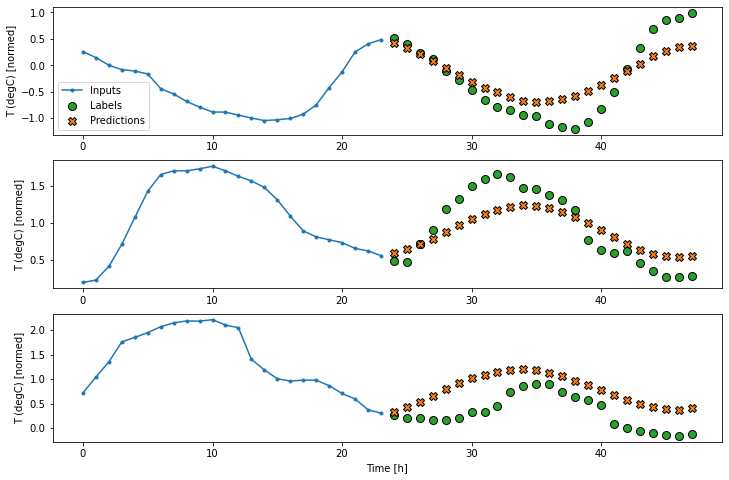

In [113]:
multi_linear_model = tf.keras.Sequential([
    # Take the last time-step.
    # Shape [batch, time, features] => [batch, 1, features]
    tf.keras.layers.Lambda(lambda x: x[:, -1:, :]),
    # Shape => [batch, 1, out_steps*features]
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features]
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history = compile_and_fit(multi_linear_model, multi_window)

IPython.display.clear_output()
multi_val_performance['Linear'] = multi_linear_model.evaluate(multi_window.val)
multi_performance['Linear'] = multi_linear_model.evaluate(multi_window.test, verbose=0)
multi_window.plot(multi_linear_model)

#### Dense

Adding a `tf.keras.layers.Dense` between the input and output gives the linear model more power, but is still only based on a single input time step.

437/437 [==============================] - 0s 985us/step - loss: 0.2179 - mean_absolute_error: 0.2800


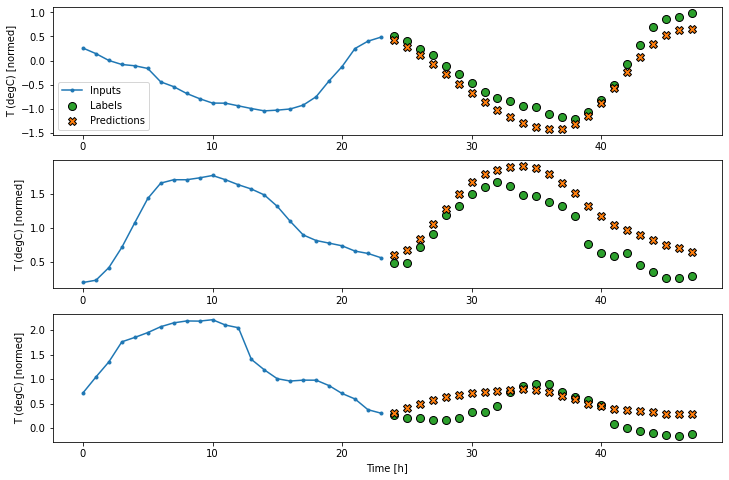

In [114]:
multi_dense_model = tf.keras.Sequential([
    # Take the last time step.
    # Shape [batch, time, features] => [batch, 1, features]
    tf.keras.layers.Lambda(lambda x: x[:, -1:, :]),
    # Shape => [batch, 1, dense_units]
    tf.keras.layers.Dense(512, activation='relu'),
    # Shape => [batch, out_steps*features]
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features]
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history = compile_and_fit(multi_dense_model, multi_window)

IPython.display.clear_output()
multi_val_performance['Dense'] = multi_dense_model.evaluate(multi_window.val)
multi_performance['Dense'] = multi_dense_model.evaluate(multi_window.test, verbose=0)
multi_window.plot(multi_dense_model)

#### CNN

A convolutional model makes predictions based on a fixed-width history, which may lead to better performance than the dense model since it can see how things are changing over time:

![A convolutional model sees how things change over time](images/multistep_conv.png)

437/437 [==============================] - 0s 946us/step - loss: 0.2151 - mean_absolute_error: 0.2806


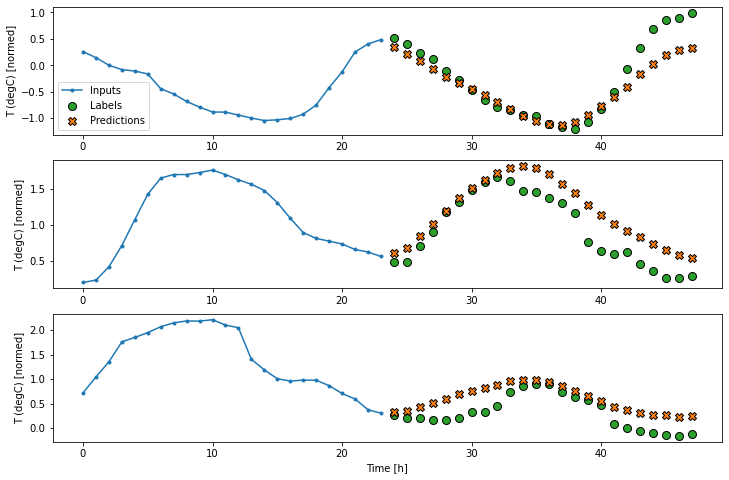

In [115]:
CONV_WIDTH = 3
multi_conv_model = tf.keras.Sequential([
    # Shape [batch, time, features] => [batch, CONV_WIDTH, features]
    tf.keras.layers.Lambda(lambda x: x[:, -CONV_WIDTH:, :]),
    # Shape => [batch, 1, conv_units]
    tf.keras.layers.Conv1D(256, activation='relu', kernel_size=(CONV_WIDTH)),
    # Shape => [batch, 1,  out_steps*features]
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features]
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history = compile_and_fit(multi_conv_model, multi_window)

IPython.display.clear_output()

multi_val_performance['Conv'] = multi_conv_model.evaluate(multi_window.val)
multi_performance['Conv'] = multi_conv_model.evaluate(multi_window.test, verbose=0)
multi_window.plot(multi_conv_model)

#### RNN

A recurrent model can learn to use a long history of inputs, if it's relevant to the predictions the model is making. Here the model will accumulate internal state for 24 hours, before making a single prediction for the next 24 hours.

In this single-shot format, the LSTM only needs to produce an output at the last time step, so set `return_sequences=False` in `tf.keras.layers.LSTM`.

![The LSTM accumulates state over the input window, and makes a single prediction for the next 24 hours](images/multistep_lstm.png)


437/437 [==============================] - 1s 2ms/step - loss: 0.2141 - mean_absolute_error: 0.2842


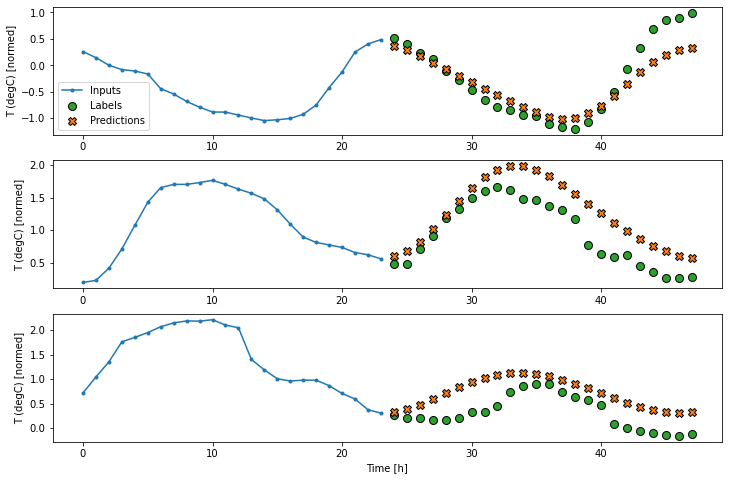

In [116]:
multi_lstm_model = tf.keras.Sequential([
    # Shape [batch, time, features] => [batch, lstm_units].
    # Adding more `lstm_units` just overfits more quickly.
    tf.keras.layers.LSTM(32, return_sequences=False),
    # Shape => [batch, out_steps*features].
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features].
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

history = compile_and_fit(multi_lstm_model, multi_window)

IPython.display.clear_output()

multi_val_performance['LSTM'] = multi_lstm_model.evaluate(multi_window.val)
multi_performance['LSTM'] = multi_lstm_model.evaluate(multi_window.test, verbose=0)
multi_window.plot(multi_lstm_model)

In [117]:
multi_lstm_model.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_3 (LSTM)                (None, 32)                6656      
_________________________________________________________________
dense_24 (Dense)             (None, 456)               15048     
_________________________________________________________________
reshape_4 (Reshape)          (None, 24, 19)            0         
Total params: 21,704
Trainable params: 21,704
Non-trainable params: 0
_________________________________________________________________


### Advanced: Autoregressive model

The above models all predict the entire output sequence in a single step.

In some cases it may be helpful for the model to decompose this prediction into individual time steps. Then, each model's output can be fed back into itself at each step and predictions can be made conditioned on the previous one, like in the classic <a href="https://arxiv.org/abs/1308.0850" class="external">Generating Sequences With Recurrent Neural Networks</a>.

One clear advantage to this style of model is that it can be set up to produce output with a varying length.

You could take any of the single-step multi-output models trained in the first half of this tutorial and run in an autoregressive feedback loop, but here you'll focus on building a model that's been explicitly trained to do that.

![Feedback a model's output to its input](images/multistep_autoregressive.png)

#### RNN

This tutorial only builds an autoregressive RNN model, but this pattern could be applied to any model that was designed to output a single time step.

The model will have the same basic form as the single-step LSTM models from earlier: a `tf.keras.layers.LSTM` layer followed by a `tf.keras.layers.Dense` layer that converts the `LSTM` layer's outputs to model predictions.

A `tf.keras.layers.LSTM` is a `tf.keras.layers.LSTMCell` wrapped in the higher level `tf.keras.layers.RNN` that manages the state and sequence results for you (Check out the [Recurrent Neural Networks (RNN) with Keras](https://www.tensorflow.org/guide/keras/rnn) guide for details).

In this case, the model has to manually manage the inputs for each step, so it uses `tf.keras.layers.LSTMCell` directly for the lower level, single time step interface.

In [119]:
class FeedBack(tf.keras.Model):
  def __init__(self, units, out_steps):
    super().__init__()
    self.out_steps = out_steps
    self.units = units
    self.lstm_cell = tf.keras.layers.LSTMCell(units)
    # Also wrap the LSTMCell in an RNN to simplify the `warmup` method.
    self.lstm_rnn = tf.keras.layers.RNN(self.lstm_cell, return_state=True)
    self.dense = tf.keras.layers.Dense(num_features)

In [120]:
feedback_model = FeedBack(units=32, out_steps=OUT_STEPS)

The first method this model needs is a `warmup` method to initialize its internal state based on the inputs. Once trained, this state will capture the relevant parts of the input history. This is equivalent to the single-step `LSTM` model from earlier:

In [121]:
def warmup(self, inputs):
  # inputs.shape => (batch, time, features)
  # x.shape => (batch, lstm_units)
  x, *state = self.lstm_rnn(inputs)

  # predictions.shape => (batch, features)
  prediction = self.dense(x)
  return prediction, state

FeedBack.warmup = warmup

This method returns a single time-step prediction and the internal state of the `LSTM`:

In [122]:
prediction, state = feedback_model.warmup(multi_window.example[0])
prediction.shape

TensorShape([32, 19])

In [128]:
print(len(state))
print(state[0].shape)
print(state[1].shape)

2
(32, 32)
(32, 32)


With the `RNN`'s state, and an initial prediction you can now continue iterating the model feeding the predictions at each step back as the input.

The simplest approach for collecting the output predictions is to use a Python list and a `tf.stack` after the loop.

Note: Stacking a Python list like this only works with eager-execution, using `Model.compile(..., run_eagerly=True)` for training, or with a fixed length output. For a dynamic output length, you would need to use a `tf.TensorArray` instead of a Python list, and `tf.range` instead of the Python `range`.

In [135]:
def call(self, inputs, training=None):
  # Use a TensorArray to capture dynamically unrolled outputs.
  predictions = []
  # Initialize the LSTM state.
  prediction, state = self.warmup(inputs)
  

  tf.print("inputs.shape = ", inputs.shape)
  tf.print("prediction.shape before for loop = ", prediction.shape)
    
  # Insert the first prediction.
  predictions.append(prediction)

  # Run the rest of the prediction steps.
  for n in range(1, self.out_steps):
    # Use the last prediction as input.
    x = prediction
    # Execute one lstm step.
    x, state = self.lstm_cell(x, states=state,
                              training=training)
    # Convert the lstm output to a prediction.
    prediction = self.dense(x)
    tf.print("prediction.shape = ", prediction.shape)
    # Add the prediction to the output.
    predictions.append(prediction)

  # the "time" below is out_time(check for loop range) and not in_timsteps
  # predictions.shape => (time, batch, features)
  predictions = tf.stack(predictions)
  
  tf.print("stacked predictions.shape = ", predictions.shape)
  
  # predictions.shape => (batch, time, features)
  predictions = tf.transpose(predictions, [1, 0, 2])
  return predictions

FeedBack.call = call

Test run this model on the example inputs:

In [136]:
multi_window.example[0].shape

TensorShape([32, 24, 19])

In [137]:
print('Output shape (batch, time, features): ', feedback_model(multi_window.example[0]).shape)

inputs.shape =  TensorShape([32, 24, 19])
prediction.shape before for loop =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =  TensorShape([32, 19])
prediction.shape =

Now, train the model:

In [138]:
history = compile_and_fit(feedback_model, multi_window)

IPython.display.clear_output()

multi_val_performance['AR LSTM'] = feedback_model.evaluate(multi_window.val)
multi_performance['AR LSTM'] = feedback_model.evaluate(multi_window.test, verbose=0)
multi_window.plot(feedback_model)

Epoch 1/20
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predi

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  34/1532 [..............................] - ETA: 37s - loss: 0.8779 - mean_absolute_error: 0.7416inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  55/1532 [>.............................] - ETA: 35s - loss: 0.8005 - mean_absolute_error: 0.6987inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  75/1532 [>.............................] - ETA: 34s - loss: 0.7475 - mean_absolute_error: 0.6701inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 102/1532 [>.............................] - ETA: 32s - loss: 0.6931 - mean_absolute_error: 0.6400inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 176/1532 [==>...........................] - ETA: 30s - loss: 0.6059 - mean_absolute_error: 0.5898inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 196/1532 [==>...........................] - ETA: 30s - loss: 0.5874 - mean_absolute_error: 0.5789inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 230/1532 [===>..........................] - ETA: 29s - loss: 0.5563 - mean_absolute_error: 0.5598inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 251/1532 [===>..........................] - ETA: 28s - loss: 0.5393 - mean_absolute_error: 0.5489inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 342/1532 [=====>........................] - ETA: 26s - loss: 0.4816 - mean_absolute_error: 0.5100inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 349/1532 [=====>........................] - ETA: 26s - loss: 0.4782 - mean_absolute_error: 0.5077inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 390/1532 [======>.......................] - ETA: 25s - loss: 0.4597 - mean_absolute_error: 0.4948inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 410/1532 [=======>......................] - ETA: 25s - loss: 0.4517 - mean_absolute_error: 0.4892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 478/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 491/1532 [========>.....................] - ETA: 23s - loss: 0.4256 - mean_absolute_error: 0.4710inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 505/1532 [========>.....................] - ETA: 23s - loss: 0.4216 - mean_absolute_error: 0.4682inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 532/1532 [=========>....................] - ETA: 22s - loss: 0.4152 - mean_absolute_error: 0.4634inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 552/1532 [=========>....................] - ETA: 22s - loss: 0.4099 - mean_absolute_error: 0.4597inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 566/1532 [==========>...................] - ETA: 21s - loss: 0.4067 - mean_absolute_error: 0.4574inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 638/1532 [===========>..................] - ETA: 20s - loss: 0.3924 - mean_absolute_error: 0.4471inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 651/1532 [===========>..................] - ETA: 20s - loss: 0.3899 - mean_absolute_error: 0.4454inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 658/1532 [===========>..................] - ETA: 20s - loss: 0.3886 - mean_absolute_error: 0.4445inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 664/1532 [============>.................] - ETA: 20s - loss: 0.3877 - mean_absolute_error: 0.4438inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 671/1532 [========

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 677/1532 [============>.................] - ETA: 20s - loss: 0.3856 - mean_absolute_error: 0.4423inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 717/1532 [=============>................] - ETA: 19s - loss: 0.3790 - mean_absolute_error: 0.4375inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 724/1532 [=============>................] - ETA: 19s - loss: 0.3779 - mean_absolute_error: 0.4367inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 758/1532 [=============>................] - ETA: 18s - loss: 0.3732 - mean_absolute_error: 0.4332inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 772/1532 [==============>...............] - ETA: 18s - loss: 0.3713 - mean_absolute_error: 0.4318inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 785/1532 [==============>...............] - ETA: 18s - loss: 0.3696 - mean_absolute_error: 0.4305inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

 836/1532 [===============>..............] - ETA: 16s - loss: 0.3627 - mean_absolute_error: 0.4254inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

 870/1532 [================>.............] - ETA: 16s - loss: 0.3589 - mean_absolute_error: 0.4225inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 897/1532 [================>.............] - ETA: 15s - loss: 0.3557 - mean_absolute_error: 0.4201inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 924/1532 [=================>............] - ETA: 14s - loss: 0.3530 - mean_absolute_error: 0.4180inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 938/1532 [=================>............] - ETA: 14s - loss: 0.3516 - mean_absolute_error: 0.4170inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 969/1532 [=================>............] - ETA: 13s - loss: 0.3487 - mean_absolute_error: 0.4147inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 983/1532 [==================>...........] - ETA: 13s - loss: 0.3475 - mean_absolute_error: 0.4138inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1003/1532 [==================>...........] - ETA: 12s - loss: 0.3457 - mean_absolute_error: 0.4124inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1010/1532 [==================>...........] - ETA: 12s - loss: 0.3452 - mean_absolute_error: 0.4120inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1051/1532 [===================>..........] - ETA: 11s - loss: 0.3418 - mean_absolute_error: 0.4093inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1071/1532 [===================>..........] - ETA: 11s - loss: 0.3405 - mean_absolute_error: 0.4082inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1133/1532 [=====================>........] - ETA: 9s - loss: 0.3363 - mean_absolute_error: 0.4049inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1147/1532 [=====================>........] - ETA: 9s - loss: 0.3354 - mean_absolute_error: 0.4042inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1174/1532 [=====================>........] - ETA: 8s - loss: 0.3336 - mean_absolute_error: 0.4028inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1188/1532 [======================>.......] - ETA: 8s - loss: 0.3327 - mean_absolute_error: 0.4021inputs.shape =  TensorShape([None, 24, 19])
prediction

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1215/1532 [======================>.......] - ETA: 7s - loss: 0.3310 - mean_absolute_error: 0.4008inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1229/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1284/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1297/1532 [========================>.....] - ETA: 5s - loss: 0.3261 - mean_absolute_error: 0.3968inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1304/1532 [========================>.....] - ETA: 5s - loss: 0.3257 - mean_absolute_error: 0.3965inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1331/1532 [=========================>....] - ETA: 4s - loss: 0.3243 - mean_absolute_error: 0.3954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1358/1532 [=========================>....] - ETA: 4s - loss: 0.3227 - mean_absolute_error: 0.3941inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1372/1532 [=========================>....] - ETA: 3s - loss: 0.3220 - mean_absolute_error: 0.3935inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1392/1532 [==========================>...] - ETA: 3s - loss: 0.3209 - mean_absolute_error: 0.3926inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1462/1532 [===========================>..] - ETA: 1s - loss: 0.3174 - mean_absolute_error: 0.3897inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1483/1532 [============================>.] - ETA: 1s - loss: 0.3166 - mean_absolute_error: 0.3890inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1510/1532 [============================>.] - ETA: 0s - loss: 0.3155 - mean_absolute_error: 0.3880inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

1530/1532 [============================>.] - ETA: 0s - loss: 0.3145 - mean_absolute_error: 0.3872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
   4/1532 [........

  10/1532 [..............................] - ETA: 33s - loss: 0.2504 - mean_absolute_error: 0.3336inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  17/1532 [..............................] - ETA: 35s - loss: 0.2462 - mean_absolute_error: 0.3306inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  24/1532 [..............................] - ETA: 35s - loss: 0.2480 - mean_absolute_error: 0.3308inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 131/1532 [=>............................] - ETA: 32s - loss: 0.2472 - mean_absolute_error: 0.3305inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 144/1532 [=>............................] - ETA: 32s - loss: 0.2464 - mean_absolute_error: 0.3300inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 185/1532 [==>...........................] - ETA: 31s - loss: 0.2453 - mean_absolute_error: 0.3292inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 205/1532 [===>..........................] - ETA: 31s - loss: 0.2457 - mean_absolute_error: 0.3294inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 226/1532 [===>..........................] - ETA: 30s - loss: 0.2458 - mean_absolute_error: 0.3295inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 300/1532 [====>.........................] - ETA: 28s - loss: 0.2452 - mean_absolute_error: 0.3288inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 314/1532 [=====>........................] - ETA: 27s - loss: 0.2447 - mean_absolute_error: 0.3284inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 348/1532 [=====>........................] - ETA: 27s - loss: 0.2447 - mean_absolute_error: 0.3282inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 362/1532 [======>.......................] - ETA: 26s - loss: 0.2444 - mean_absolute_error: 0.3280inputs.sh

 368/1532 [======>.......................] - ETA: 26s - loss: 0.2444 - mean_absolute_error: 0.3280inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 409/1532 [=======>......................] - ETA: 25s - loss: 0.2438 - mean_absolute_error: 0.3273inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 502/1532 [========>.....................] - ETA: 23s - loss: 0.2430 - mean_absolute_error: 0.3267inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 522/1532 [=========>....................] - ETA: 22s - loss: 0.2432 - mean_absolute_error: 0.3267inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 536/1532 [=========>....................] - ETA: 22s - loss: 0.2431 - mean_absolute_error: 0.3266inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 627/1532 [===========>..................] - ETA: 20s - loss: 0.2416 - mean_absolute_error: 0.3255inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 654/1532 [===========>..................] - ETA: 19s - loss: 0.2415 - mean_absolute_error: 0.3252inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 675/1532 [============>.................] - ETA: 19s - loss: 0.2412 - mean_absolute_error: 0.3251inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 688/1532 [============>.................] - ETA: 19s - loss: 0.2409 - mean_absolute_error: 0.3248inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 702/1532 [============>.................] - ETA: 18s - loss: 0.2406 - mean_absolute_error: 0.3246inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 722/1532 [=============>................] - ETA: 18s - loss: 0.2405 - mean_absolute_error: 0.3244inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 793/1532 [==============>...............] - ETA: 16s - loss: 0.2396 - mean_absolute_error: 0.3238inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 814/1532 [========

 820/1532 [===============>..............] - ETA: 16s - loss: 0.2391 - mean_absolute_error: 0.3234inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 834/1532 [===============>..............] - ETA: 15s - loss: 0.2391 - mean_absolute_error: 0.3234inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 861/1532 [===============>..............] - ETA: 15s - loss: 0.2388 - mean_absolute_error: 0.3231inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 882/1532 [================>.............] - ETA: 14s - loss: 0.2387 - mean_absolute_error: 0.3230inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 938/1532 [=================>............] - ETA: 13s - loss: 0.2381 - mean_absolute_error: 0.3225inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 952/1532 [=================>............] - ETA: 13s - loss: 0.2381 - mean_absolute_error: 0.3225inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 979/1532 [==================>...........] - ETA: 12s - loss: 0.2382 - mean_absolute_error: 0.3224inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 993/1532 [==================>...........] - ETA: 12s - loss: 0.2382 - mean_absolute_error: 0.3224inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1013/1532 [==================>...........] - ETA: 11s - loss: 0.2380 - mean_absolute_error: 0.3222inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
1033/1532 [===================>..........] - ETA: 11s - loss: 0.2379 - mean_absolute_error: 0.3221inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1110/1532 [====================>.........] - ETA: 9s - loss: 0.

1116/1532 [====================>.........] - ETA: 9s - loss: 0.2380 - mean_absolute_error: 0.3220inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1130/1532 [=====================>........] - ETA: 9s - loss: 0.2381 - mean_absolute_error: 0.3220inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

1150/1532 [=====================>........] - ETA: 8s - loss: 0.2379 - mean_absolute_error: 0.3218inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1171/1532 [=====================>........] - ETA: 8s - loss: 0.2378 - mean_absolute_error: 0.3217inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1249/1532 [=======================>......] - ETA: 6s - loss: 0.2374 - mean_absolute_error: 0.3212inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1263/1532 [=======================>......] - ETA: 6s - loss: 0.2374 - mean_absolute_error: 0.3212inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1283/1532 [========================>.....] - ETA: 5s - loss: 0.2375 - mean_absolute_error: 0.3211inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1297/1532 [========================>.....] - ETA: 5s - loss: 0.2373 - mean_absolute_error: 0.3210inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1317/1532 [========================>.....] - ETA: 4s - loss: 0.2374 - mean_absolute_error: 0.3210inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1338/1532 [=========================>....] - ETA: 4s - loss: 0.2372 - mean_absolute_error: 0.3208inputs.shape =  TensorShape([None, 24, 19])
prediction

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1410/1532 [==========================>...] - ETA: 2s - loss: 0.2367 - mean_absolute_error: 0.3203inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1431/1532 [===========================>..] - ETA: 2s - loss: 0.2366 - mean_absolute_error: 0.3201inputs.sha

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1498/1532 [============================>.] - ETA: 0s - loss: 0.2365 - mean_absolute_error: 0.3199inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  85/1532 [>.............................] - ETA: 33s - loss: 0.2300 - mean_absolute_error: 0.3120inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 112/1532 [=>............................] - ETA: 32s - loss: 0.2301 - mean_absolute_error: 0.3116inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 168/1532 [==>...........................] - ETA: 31s - loss: 0.2293 - mean_absolute_error: 0.3107inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 181/1532 [==>...........................] - ETA: 31s - loss: 0.2288 - mean_absolute_error: 0.3105inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 188/1532 [==>...........................] - ETA: 31s - loss: 0.2290 - mean_absolute_error: 0.3105inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 208/1532 [===>..........................] - ETA: 31s - loss: 0.2291 - mean_absolute_error: 0.3103inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 271/1532 [====>.........................] - ETA: 30s - loss: 0.2280 - mean_absolute_error: 0.3095inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 284/1532 [====>.........................] - ETA: 29s - loss: 0.2282 - mean_absolute_error: 0.3095inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 311/1532 [=====>........................] - ETA: 29s - loss: 0.2278 - mean_absolute_error: 0.3092inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 332/1532 [=====>........................] - ETA: 29s - loss: 0.2278 - mean_absolute_error: 0.3093inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 345/1532 [=====>........................] - ETA: 28s - loss: 0.2280 - mean_absolute_error: 0.3094inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 359/1532 [======>.......................] - ETA: 28s - loss: 0.2275 - mean_absolute_error: 0.3091inputs.sh

 365/1532 [======>.......................] - ETA: 28s - loss: 0.2275 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 418/1532 [=======>......................] - ETA: 27s - loss: 0.2276 - mean_absolute_error: 0.3090inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 425/1532 [=======>......................] - ETA: 27s - loss: 0.2276 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 432/1532 [=======>......................] - ETA: 27s - loss: 0.2275 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 452/1532 [=======>......................] - ETA: 26s - loss: 0.2275 - mean_absolute_error: 0.3092inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 472/1532 [========>.....................] - ETA: 26s - loss: 0.2273 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 486/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 492/1532 [========>.....................] - ETA: 26s - loss: 0.2274 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 506/1532 [========>.....................] - ETA: 26s - loss: 0.2273 - mean_absolute_error: 0.3090inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 512/1532 [=========>....................] - ETA: 26s - loss: 0.2275 - mean_absolute_error: 0.3091inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 526/1532 [=========>....................] - ETA: 25s - loss: 0.2274 - mean_absolute_error: 0.3090inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 546/1532 [=========>....................] - ETA: 25s - loss: 0.2270 - mean_absolute_error: 0.3088inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 560/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 566/1532 [==========>...................] - ETA: 25s - loss: 0.2271 - mean_absolute_error: 0.3088inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 580/1532 [==========>...................] - ETA: 24s - loss: 0.2270 - mean_absolute_error: 0.3088inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 586/1532 [==========>...................] - ETA: 24s - loss: 0.2269 - mean_absolute_error: 0.3087inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 613/1532 [===========>..................] - ETA: 24s - loss: 0.2266 - mean_absolute_error: 0.3085inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 640/1532 [===========>..................] - ETA: 23s - loss: 0.2267 - mean_absolute_error: 0.3086inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 647/1532 [===========>..................] - ETA: 23s - loss: 0.2267 - mean_absolute_error: 0.3086inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 667/1532 [============>.................] - ETA: 22s - loss: 0.2264 - mean_absolute_error: 0.3084inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 681/1532 [============>.................] - ETA: 22s - loss: 0.2263 - mean_absolute_error: 0.3084inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 694/1532 [============>.................] - ETA: 22s - loss: 0.2263 - mean_absolute_error: 0.3084inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 708/1532 [============>.................] - ETA: 21s - loss: 0.2263 - mean_absolute_error: 0.3083inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 721/1532 [=============>................] - ETA: 21s - loss: 0.2260 - mean_absolute_error: 0.3081inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 728/1532 [=============>................] - ETA: 21s - loss: 0.2259 - mean_absolute_error: 0.3081inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 748/1532 [=============>................] - ETA: 20s - loss: 0.2258 - mean_absolute_error: 0.3080inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 755/1532 [=============>................] - ETA: 20s - loss: 0.2257 - mean_absolute_error: 0.3080inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 802/1532 [==============>...............] - ETA: 19s - loss: 0.2254 - mean_absolute_error: 0.3078inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 809/1532 [==============>...............] - ETA: 19s - loss: 0.2253 - mean_absolute_error: 0.3077inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 822/1532 [===============>..............] - ETA: 18s - loss: 0.2253 - mean_absolute_error: 0.3077inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 877/1532 [================>.............] - ETA: 17s - loss: 0.2250 - mean_absolute_error: 0.3075inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 883/1532 [================>.............] - ETA: 17s - loss: 0.2248 - mean_absolute_error: 0.3074inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 904/1532 [================>.............] - ETA: 16s - loss: 0.2247 - mean_absolute_error: 0.3073inputs.sh

 910/1532 [================>.............] - ETA: 16s - loss: 0.2247 - mean_absolute_error: 0.3073inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 924/1532 [=================>............] - ETA: 16s - loss: 0.2247 - mean_absolute_error: 0.3073inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 937/1532 [=================>............] - ETA: 15s - loss: 0.2246 - mean_absolute_error: 0.3072inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 951/1532 [=================>............] - ETA: 15s - loss: 0.2246 - mean_absolute_error: 0.3072inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 971/1532 [==================>...........] - ETA: 14s - loss: 0.2247 - mean_absolute_error: 0.3072inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 991/1532 [==================>...........] - ETA: 14s - loss: 0.2247 - mean_absolute_error: 0.3072inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1112/1532 [====================>.........] - ETA: 10s - loss: 0.2248 - mean_absolute_error: 0.3071inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1126/1532 [=====================>........] - ETA: 10s - loss: 0.2248 - mean_absolute_error: 0.3071inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
1139/1532 [=====================>........] - ETA: 10s - loss: 0.2247 - mean_absolute_error: 0.3070inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
1195/1532 [======================>.......] - ETA: 8s - loss: 0.2246 - mean_absolute_error: 0.3069inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1202/1532 [======================>.......] - ETA: 8s - loss: 0.2246 - mean_absolute_error: 0.3069inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1209/1532 [======================>.......] - ETA: 8s - loss: 0.2246 - mean_absolute_error: 0.3068inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1236/1532 [=======================>......] - ETA: 7s - loss: 0.2244 - mean_absolute_error: 0.3067inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1243/1532 [=======================>......] - ETA: 7s - loss: 0.2245 - mean_absolute_error: 0.3067inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1263/1532 [=======================>......] - ETA: 6s - loss: 0.2245 - mean_absolute_error: 0.3067inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1297/1532 [========================>.....] - ETA: 6s - loss: 0.2245 - mean_absolute_error: 0.3066inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1344/1532 [=========================>....] - ETA: 4s - loss: 0.2244 - mean_absolute_error: 0.3065inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1358/1532 [=========================>....] - ETA: 4s - loss: 0.2243 - mean_absolute_error: 0.3064inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1392/1532 [==========================>...] - ETA: 3s - loss: 0.2243 - mean_absolute_error: 0.3064inputs.shape =  TensorShape([None, 24, 19])
prediction

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1419/1532 [==========================>...] - ETA: 2s - loss: 0.2241 - mean_absolute_error: 0.3062inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1487/1532 [============================>.] - ETA: 1s - loss: 0.2242 - mean_absolute_error: 0.3062inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1501/1532 [============================>.] - ETA: 0s - loss: 0.2242 - mean_absolute_error: 0.3062inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1521/1532 [============================>.] - ETA: 0s - loss: 0.2242 - mean_absolute_error: 0.3061inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
   4/1532 [..............................] - ETA: 32s - loss: 0.2201 - mean_absolute_error: 0.3044inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  17/1532 [..............................] - ETA: 36s - loss: 0.2159 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 211/1532 [===>..........................] - ETA: 31s - loss: 0.2211 - mean_absolute_error: 0.3016inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 252/1532 [===>..........................] - ETA: 30s - loss: 0.2206 - mean_absolute_error: 0.3012inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 266/1532 [====>...

 272/1532 [====>.........................] - ETA: 29s - loss: 0.2207 - mean_absolute_error: 0.3014inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 286/1532 [====>.........................] - ETA: 29s - loss: 0.2209 - mean_absolute_error: 0.3015inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 300/1532 [====>.........................] - ETA: 28s - loss: 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 360/1532 [======>.......................] - ETA: 27s - loss: 0.2199 - mean_absolute_error: 0.3008inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 374/1532 [======>.......................] - ETA: 26s - loss: 0.2200 - mean_absolute_error: 0.3008inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 401/1532 [======>.......................] - ETA: 26s - loss: 0.2195 - mean_absolute_error: 0.3006inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 415/1532 [=======>......................] - ETA: 25s - loss: 0.2202 - mean_absolute_error: 0.3010inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 435/1532 [=======>......................] - ETA: 25s - loss: 0.2199 - mean_absolute_error: 0.3009inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 455/1532 [=======>......................] - ETA: 25s - loss: 0.2198 - mean_absolute_error: 0.3008inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 504/1532 [========>.....................] - ETA: 23s - loss: 0.2196 - mean_absolute_error: 0.3007inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 524/1532 [=========>....................] - ETA: 23s - loss: 0.2196 - mean_absolute_error: 0.3006inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 558/1532 [=========>....................] - ETA: 22s - loss: 0.2193 - mean_absolute_error: 0.3004inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 572/1532 [==========>...................] - ETA: 22s - loss: 0.2194 - mean_absolute_error: 0.3005inputs.sh

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 585/1532 [==========>...................] - ETA: 22s - loss: 0.2193 - mean_absolute_error: 0.3005inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 659/1532 [===========>..................] - ETA: 20s - loss: 0.2188 - mean_absolute_error: 0.3002inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 672/1532 [============>.................] - ETA: 20s - loss: 0.2187 - mean_absolute_error: 0.3002inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 699/1532 [============>.................] - ETA: 19s - loss: 0.2186 - mean_absolute_error: 0.3001inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 713/1532 [============>.................] - ETA: 19s - loss: 0.2184 - mean_absolute_error: 0.2999inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 726/1532 [=============>................] - ETA: 19s - loss: 0.2183 - mean_absolute_error: 0.2998inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 740/1532 [=============>................] - ETA: 18s - loss: 0.2182 - mean_absolute_error: 0.2998inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 796/1532 [==============>...............] - ETA: 17s - loss: 0.2177 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 810/1532 [==============>...............] - ETA: 17s - loss: 0.2176 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 823/1532 [===============>..............] - ETA: 16s - loss: 0.2175 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 830/1532 [===============>..............] - ETA: 16s - loss: 0.2175 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 837/1532 [===============>..............] - ETA: 16s - loss: 0.2175 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 850/1532 [===============>..............] - ETA: 16s - loss: 0.2176 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 864/1532 [===============>..............] - ETA: 15s - loss: 0.2176 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 891/1532 [================>.............] - ETA: 15s - loss: 0.2175 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 898/1532 [================>.............] - ETA: 15s - loss: 0.2174 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



stacked predictions.shape =  TensorShape([24, None, 19])
 937/1532 [=================>............] - ETA: 14s - loss: 0.2174 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 944/1532 [=================>............] - ETA: 14s - loss: 0.2173 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 971/1532 [==================>...........] - ETA: 13s - loss: 0.2175 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 985/1532 [==================>...........] - ETA: 13s - loss: 0.2174 - mean_absolute_error: 0.2992inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1039/1532 [===================>..........] - ETA: 11s - loss: 0.2175 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1094/1532 [====================>.........] - ETA: 10s - loss: 0.2178 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1108/1532 [====================>.........] - ETA: 10s - loss: 0.2178 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1128/1532 [=====================>........] - ETA: 9s - loss: 0.2179 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1142/1532 [=====================>........] - ETA: 9s - loss: 0.2178 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1162/1532 [=====================>........] - ETA: 8s - loss: 0.2178 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1176/1532 [======================>.......] - ETA: 8s - loss: 0.2179 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1196/1532 [======================>.......] - ETA: 8s - loss: 0.2177 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1249/1532 [=======================>......] - ETA: 6s - loss: 0.2177 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1263/1532 [=======================>......] - ETA: 6s - loss: 0.

1269/1532 [=======================>......] - ETA: 6s - loss: 0.2178 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1283/1532 [========================>.....] - ETA: 5s - loss: 0.2178 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1303/1532 [========================>.....] - ETA: 5s - loss: 0.2180 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1330/1532 [=========================>....] - ETA: 4s - loss: 0.2179 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1337/1532 [=========================>....] - ETA: 4s - loss: 0.2179 - mean_absolute_error: 0.2994inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1350/1532 [=========================>....] - ETA: 4s - loss: 0.2178 - mean_absolute_error: 0.2993inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1371/1532 [========

1377/1532 [=========================>....] - ETA: 3s - loss: 0.2177 - mean_absolute_error: 0.2992inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1449/1532 [===========================>..] - ETA: 1s - loss: 0.2176 - mean_absolute_error: 0.2991inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1470/1532 [===========================>..] - ETA: 1s - loss: 0.2178 - mean_absolute_error: 0.2992inputs.shape =  TensorShape([None, 24, 19])
prediction

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1497/1532 [============================>.] - ETA: 0s - loss: 0.2177 - mean_absolute_error: 0.2992inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1517/1532 [============================>.] - ETA: 0s - loss: 0.2178 - mean_absolute_error: 0.2991inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
  42/1532 [..............................] - ETA: 39s - loss: 0.2177 - mean_absolute_error: 0.2955inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  49/1532 [..............................] - ETA: 39s - loss: 0.2153 - mean_absolute_error: 0.2945inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 125/1532 [=>............................] - ETA: 35s - loss: 0.2171 - mean_absolute_error: 0.2970inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 138/1532 [=>............................] - ETA: 35s - loss: 0.2178 - mean_absolute_error: 0.2973inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 145/1532 [=>............................] - ETA: 35s - loss: 0.2170 - mean_absolute_error: 0.2969inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 152/1532 [=>............................] - ETA: 35s - loss: 0.2170 - mean_absolute_error: 0.2970inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 172/1532 [==>...........................] - ETA: 35s - loss: 0.2171 - mean_absolute_error: 0.2968inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 179/1532 [==>...........................] - ETA: 35s - loss: 0.2165 - mean_absolute_error: 0.2965inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 209/1532 [===>..........................] - ETA: 34s - loss: 0.2164 - mean_absolute_error: 0.2963inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 236/1532 [===>..........................] - ETA: 33s - loss: 0.2164 - mean_absolute_error: 0.2964inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 278/1532 [====>.........................] - ETA: 31s - loss: 0.2165 - mean_absolute_error: 0.2963inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 292/1532 [====>.........................] - ETA: 31s - loss: 0.2164 - mean_absolute_error: 0.2963inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 299/1532 [====>.........................] - ETA: 31s - loss: 0.2163 - mean_absolute_error: 0.2962inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 312/1532 [=====>........................] - ETA: 31s - loss: 0.2163 - mean_absolute_error: 0.2963inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 333/1532 [=====>........................] - ETA: 30s - loss: 0.2157 - mean_absolute_error: 0.2958inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 353/1532 [=====>........................] - ETA: 29s - loss: 0.2155 - mean_absolute_error: 0.2957inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 360/1532 [======>.......................] - ETA: 29s - loss: 0.2156 - mean_absolute_error: 0.2957inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 367/1532 [======>.......................] - ETA: 29s - loss: 0.2155 - mean_absolute_error: 0.2957inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 387/1532 [======>.......................] - ETA: 29s - loss: 0.2161 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 427/1532 [=======>......................] - ETA: 27s - loss: 0.2158 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 461/1532 [========>.....................] - ETA: 27s - loss: 0.2157 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 468/1532 [========>.....................] - ETA: 26s - loss: 0.2156 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 495/1532 [========>.....................] - ETA: 26s - loss: 0.2154 - mean_absolute_error: 0.2957inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 522/1532 [=========>....................] - ETA: 25s - loss: 0.2157 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 529/1532 [=========>....................] - ETA: 25s - loss: 0.2157 - mean_absolute_error: 0.2960inputs.shape =  TensorShape([None, 24, 19])
predictio

 535/1532 [=========>....................] - ETA: 25s - loss: 0.2156 - mean_absolute_error: 0.2960inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 562/1532 [==========>...................] - ETA: 24s - loss: 0.2156 - mean_absolute_error: 0.2961inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 603/1532 [==========>...................] - ETA: 23s - loss: 0.2151 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 637/1532 [===========>..................] - ETA: 22s - loss: 0.2150 - mean_absolute_error: 0.2958inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 650/1532 [===========>..................] - ETA: 22s - loss: 0.2150 - mean_absolute_error: 0.2959inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 684/1532 [============>.................] - ETA: 21s - loss: 0.2148 - mean_absolute_error: 0.2958inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 691/1532 [============>.................] - ETA: 21s - loss: 0.2147 - mean_absolute_error: 0.2958inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 755/1532 [=============>................] - ETA: 19s - loss: 0.2143 - mean_absolute_error: 0.2956inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 762/1532 [=============>................] - ETA: 19s - loss: 0.2144 - mean_absolute_error: 0.2956inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 769/1532 [==============>...............] - ETA: 19s - loss: 0.2144 - mean_absolute_error: 0.2956inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 775/1532 [==============>...............] - ETA: 19s - loss: 0.2144 - mean_absolute_error: 0.2957inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 789/1532 [==============>...............] - ETA: 18s - loss: 0.2143 - mean_absolute_error: 0.2957inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 802/1532 [==============>...............] - ETA: 18s - loss: 0.2141 - mean_absolute_error: 0.2955inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 809/1532 [==============>...............] - ETA: 18s - loss: 0.2140 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 836/1532 [===============>..............] - ETA: 17s - loss: 0.2139 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 890/1532 [================>.............] - ETA: 16s - loss: 0.2138 - mean_absolute_error: 0.2953inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 946/1532 [=================>............] - ETA: 14s - loss: 0.2137 - mean_absolute_error: 0.2953inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 973/1532 [==================>...........] - ETA: 14s - loss: 0.2138 - mean_absolute_error: 0.2953inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 993/1532 [==================>...........] - ETA: 13s - loss: 0.2138 - mean_absolute_error: 0.2953inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1007/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1013/1532 [==================>...........] - ETA: 13s - loss: 0.2138 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1020/1532 [==================>...........] - ETA: 13s - loss: 0.2137 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1047/1532 [===================>..........] - ETA: 12s - loss: 0.2137 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1061/1532 [===================>..........] - ETA: 11s - loss: 0.2138 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1074/1532 [====================>.........] - ETA: 11s - loss: 0.2140 - mean_absolute_error: 0.2953inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1140/1532 [=====================>........] - ETA: 9s - loss: 0.2142 - mean_absolute_error: 0.2955 inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1176/1532 [======================>.......] - ETA: 9s - loss: 0.2143 - mean_absolute_error: 0.2955inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1190/1532 [======================>.......] - ETA: 8s - loss: 0.2142 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1203/1532 [======================>.......] - ETA: 8s - loss: 0.2141 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
1230/1532 [=======================>......] - ETA: 7s - loss: 0.2139 - mean_absolute_error: 0.2953inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1271/1532 [=======================>......] - ETA: 6s - loss: 0.2141 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1278/1532 [========================>.....] - ETA: 6s - loss: 0.2142 - mean_absolute_error: 0.2954inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1330/1532 [=========================>....] - ETA: 5s - loss: 0.2141 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1344/1532 [=========================>....] - ETA: 4s - loss: 0.2141 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1378/1532 [=========================>....] - ETA: 3s - loss: 0.2140 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

1391/1532 [==========================>...] - ETA: 3s - loss: 0.2139 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1412/1532 [==========================>...] - ETA: 3s - loss: 0.2139 - mean_absolute_error: 0.2951inputs.sha

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1476/1532 [===========================>..] - ETA: 1s - loss: 0.2140 - mean_absolute_error: 0.2952inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1496/1532 [============================>.] - ETA: 0s - loss: 0.2139 - mean_absolute_error: 0.2951inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1516/1532 [============================>.] - ETA: 0s - loss: 0.2141 - mean_absolute_error: 0.2951inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1523/1532 [============================>.] - ETA: 0s - loss: 0.2141 - mean_absolute_error: 0.2951inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  13/1532 [........

  19/1532 [..............................] - ETA: 33s - loss: 0.2112 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 148/1532 [=>............................] - ETA: 33s - loss: 0.2140 - mean_absolute_error: 0.2941inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 162/1532 [==>...........................] - ETA: 33s - loss: 0.2144 - mean_absolute_error: 0.2942inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 175/1532 [==>...........................] - ETA: 33s - loss: 0.2132 - mean_absolute_error: 0.2934inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 189/1532 [==>...........................] - ETA: 33s - loss: 0.2127 - mean_absolute_error: 0.2931inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 202/1532 [==>...........................] - ETA: 33s - loss: 0.2128 - mean_absolute_error: 0.2932inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 216/1532 [===>..........................] - ETA: 34s - loss: 0

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 229/1532 [===>..........................] - ETA: 34s - loss: 0.2130 - mean_absolute_error: 0.2932inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 313/1532 [=====>........................] - ETA: 32s - loss: 0.2120 - mean_absolute_error: 0.2923inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 334/1532 [=====>........................] - ETA: 31s - loss: 0.2118 - mean_absolute_error: 0.2921inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 354/1532 [=====>........................] - ETA: 31s - loss: 0.2116 - mean_absolute_error: 0.2921inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 381/1532 [======>.......................] - ETA: 30s - loss: 0.2117 - mean_absolute_error: 0.2921inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 467/1532 [========>.....................] - ETA: 27s - loss: 0.2118 - mean_absolute_error: 0.2925inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 481/1532 [========>.....................] - ETA: 27s - loss: 0.2117 - mean_absolute_error: 0.2924inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 487/1532 [========>.....................] - ETA: 27s - loss: 0.2115 - mean_absolute_error: 0.2923inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 494/1532 [========>.....................] - ETA: 27s - loss: 0.2115 - mean_absolute_error: 0.2922inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 521/1532 [=========>....................] - ETA: 26s - loss: 0.2116 - mean_absolute_error: 0.2923inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 535/1532 [=========>....................] - ETA: 25s - loss: 0.2118 - mean_absolute_error: 0.2924inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 548/1532 [=========>....................] - ETA: 25s - loss: 0.2114 - mean_absolute_error: 0.2922inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 569/1532 [========

 575/1532 [==========>...................] - ETA: 24s - loss: 0.2111 - mean_absolute_error: 0.2921inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 629/1532 [===========>..................] - ETA: 23s - loss: 0.2110 - mean_absolute_error: 0.2921inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 636/1532 [===========>..................] - ETA: 23s - loss: 0.2111 - mean_absolute_error: 0.2921inputs.sh

 642/1532 [===========>..................] - ETA: 23s - loss: 0.2111 - mean_absolute_error: 0.2921inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 669/1532 [============>.................] - ETA: 22s - loss: 0.2107 - mean_absolute_error: 0.2920inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 690/1532 [============>.................] - ETA: 22s - loss: 0.2106 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 703/1532 [============>.................] - ETA: 21s - loss: 0.2107 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 724/1532 [=============>................] - ETA: 21s - loss: 0

stacked predictions.shape =  TensorShape([24, None, 19])
 730/1532 [=============>................] - ETA: 21s - loss: 0.2105 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 737/1532 [=============>................] - ETA: 20s - loss: 0.2105 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 744/1532 [=============>................] - ETA: 20s - loss: 0.2104 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 764/1532 [=============>................] - ETA: 20s - loss: 0.2105 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 794/1532 [==============>...............] - ETA: 19s - loss: 0.2103 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 821/1532 [===============>..............] - ETA: 18s - loss: 0.2102 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 835/1532 [===============>..............] - ETA: 18s - loss: 0.2102 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 862/1532 [===============>..............] - ETA: 17s - loss: 0.2101 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 882/1532 [================>.............] - ETA: 17s - loss: 0.2100 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 889/1532 [================>.............] - ETA: 16s - loss: 0.2100 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 902/1532 [================>.............] - ETA: 16s - loss: 0.2100 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 916/1532 [================>.............] - ETA: 16s - loss: 0.2099 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 959/1532 [=================>............] - ETA: 14s - loss: 0.2099 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 980/1532 [==================>...........] - ETA: 14s - loss: 0.2101 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1020/1532 [==================>...........] - ETA: 13s - loss: 0.2101 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1034/1532 [===================>..........] - ETA: 12s - loss: 0

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1091/1532 [====================>.........] - ETA: 11s - loss: 0.2104 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1118/1532 [====================>.........] - ETA: 10s - loss: 0.2104 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1125/1532 [=====================>........] - ETA: 10s - loss: 0.2105 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1139/1532 [========

1145/1532 [=====================>........] - ETA: 10s - loss: 0.2105 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1166/1532 [=====================>........] - ETA: 9s - loss: 0.2105 - mean_absolute_error: 0.2919inputs.sha

1172/1532 [=====================>........] - ETA: 9s - loss: 0.2105 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1179/1532 [======================>.......] - ETA: 9s - loss: 0.2104 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1193/1532 [======================>.......] - ETA: 8s - loss: 0.2105 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1301/1532 [========================>.....] - ETA: 5s - loss: 0.

1307/1532 [========================>.....] - ETA: 5s - loss: 0.2104 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1314/1532 [========================>.....] - ETA: 5s - loss: 0.2105 - mean_absolute_error: 0.2918inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1321/1532 [========================>.....] - ETA: 5s - loss: 0.2104 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1328/1532 [=========================>....] - ETA: 5s - loss: 0.2103 - mean_absolute_error: 0.2917inputs.sha

1334/1532 [=========================>....] - ETA: 5s - loss: 0.2104 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1348/1532 [=========================>....] - ETA: 4s - loss: 0.2103 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1361/1532 [=========================>....] - ETA: 4s - loss: 0.2102 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1402/1532 [==========================>...] - ETA: 3s - loss: 0.2102 - mean_absolute_error: 0.2915inputs.sha

1408/1532 [==========================>...] - ETA: 3s - loss: 0.2102 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1415/1532 [==========================>...] - ETA: 3s - loss: 0.2102 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1422/1532 [==========================>...] - ETA: 2s - loss: 0.2101 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1442/1532 [===========================>..] - ETA: 2s - loss: 0.2103 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1456/1532 [===========================>..] - ETA: 1s - loss: 0.2103 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1463/1532 [===========================>..] - ETA: 1s - loss: 0.2104 - mean_absolute_error: 0.2916inputs.sha

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1510/1532 [============================>.] - ETA: 0s - loss: 0.2103 - mean_absolute_error: 0.2916inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1531/1532 [========

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1532/1532 [==============================] - 45s 29ms/step - loss: 0.2103 - mean_absolute_error: 0.2916 - val_loss: 0.2255 - val_mean_absolute_error: 0.3026
Epoch 7/20
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
   7/1532 [..............................] - ETA: 47s - loss: 0.2153 - mean_absolute_error: 0.2955inputs.sh

  13/1532 [..............................] - ETA: 45s - loss: 0.2181 - mean_absolute_error: 0.2974inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  40/1532 [..............................] - ETA: 42s - loss: 0.2152 - mean_absolute_error: 0.2936inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  54/1532 [>.............................] - ETA: 46s - loss: 0

stacked predictions.shape =  TensorShape([24, None, 19])
  60/1532 [>.............................] - ETA: 47s - loss: 0.2118 - mean_absolute_error: 0.2917inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  74/1532 [>.............................] - ETA: 48s - loss: 0.2116 - mean_absolute_error: 0.2925inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  87/1532 [>.............................] - ETA: 47s - loss: 0.2121 - mean_absolute_error: 0.2930inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 153/1532 [=>............................] - ETA: 40s - loss: 0.2128 - mean_absolute_error: 0.2929inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 166/1532 [==>...........................] - ETA: 39s - loss: 0.2117 - mean_absolute_error: 0.2923inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 193/1532 [==>...........................] - ETA: 38s - loss: 0.2113 - mean_absolute_error: 0.2919inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 200/1532 [==>...........................] - ETA: 37s - loss: 0.2116 - mean_absolute_error: 0.2920inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 227/1532 [===>..........................] - ETA: 36s - loss: 0.2110 - mean_absolute_error: 0.2915inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 247/1532 [===>..........................] - ETA: 36s - loss: 0.2104 - mean_absolute_error: 0.2910inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 261/1532 [====>.........................] - ETA: 36s - loss: 0.2102 - mean_absolute_error: 0.2908inputs.sh

 267/1532 [====>.........................] - ETA: 36s - loss: 0.2101 - mean_absolute_error: 0.2908inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 281/1532 [====>.........................] - ETA: 36s - loss: 0.2104 - mean_absolute_error: 0.2910inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 301/1532 [====>.........................] - ETA: 35s - loss: 0.2100 - mean_absolute_error: 0.2907inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 321/1532 [=====>........................] - ETA: 35s - loss: 0.2098 - mean_absolute_error: 0.2906inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 328/1532 [=====>........................] - ETA: 35s - loss: 0.2097 - mean_absolute_error: 0.2905inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 348/1532 [=====>........................] - ETA: 34s - loss: 0.2093 - mean_absolute_error: 0.2903inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 368/1532 [======>.......................] - ETA: 34s - loss: 0.2095 - mean_absolute_error: 0.2904inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 395/1532 [======>.......................] - ETA: 33s - loss: 0.2092 - mean_absolute_error: 0.2901inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 402/1532 [======>.......................] - ETA: 33s - loss: 0.2092 - mean_absolute_error: 0.2901inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 408/1532 [======>.......................] - ETA: 33s - loss: 0.2092 - mean_absolute_error: 0.2900inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 422/1532 [=======>......................] - ETA: 32s - loss: 0.2092 - mean_absolute_error: 0.2901inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 442/1532 [=======>......................] - ETA: 32s - loss: 0.2091 - mean_absolute_error: 0.2900inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 449/1532 [=======>......................] - ETA: 31s - loss: 0.2092 - mean_absolute_error: 0.2901inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 456/1532 [=======>

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 544/1532 [=========>....................] - ETA: 28s - loss: 0.2087 - mean_absolute_error: 0.2897inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 598/1532 [==========>...................] - ETA: 26s - loss: 0.2080 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 605/1532 [==========>...................] - ETA: 25s - loss: 0.2079 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 639/1532 [===========>..................] - ETA: 25s - loss: 0.2082 - mean_absolute_error: 0.2896inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 652/1532 [===========>..................] - ETA: 24s - loss: 0.2081 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 687/1532 [============>.................] - ETA: 23s - loss: 0.2080 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 708/1532 [============>.................] - ETA: 22s - loss: 0.2077 - mean_absolute_error: 0.2893inputs.sh

 714/1532 [============>.................] - ETA: 22s - loss: 0.2077 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 755/1532 [=============>................] - ETA: 21s - loss: 0.2074 - mean_absolute_error: 0.2891inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 762/1532 [=============>................] - ETA: 21s - loss: 0.2075 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 775/1532 [==============>...............] - ETA: 20s - loss: 0.2075 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 782/1532 [==============>...............] - ETA: 20s - loss: 0.2076 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 789/1532 [==============>...............] - ETA: 20s - loss: 0.2075 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 836/1532 [===============>..............] - ETA: 18s - loss: 0.2071 - mean_absolute_error: 0.2891inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 843/1532 [===============>..............] - ETA: 18s - loss: 0.2069 - mean_absolute_error: 0.2890inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 904/1532 [================>.............] - ETA: 17s - loss: 0.2069 - mean_absolute_error: 0.2889inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 986/1532 [==================>...........] - ETA: 14s - loss: 0.2070 - mean_absolute_error: 0.2890inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 999/1532 [==================>...........] - ETA: 14s - loss: 0.2071 - mean_absolute_error: 0.2890inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1026/1532 [===================>..........] - ETA: 13s - loss: 0.2071 - mean_absolute_error: 0.2890inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1060/1532 [===================>..........] - ETA: 12s - loss: 0.2071 - mean_absolute_error: 0.2890inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1087/1532 [====================>.........] - ETA: 11s - loss: 0.2075 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1101/1532 [====================>.........] - ETA: 11s - loss: 0.2074 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1134/1532 [=====================>........] - ETA: 10s - loss: 0.2076 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

1154/1532 [=====================>........] - ETA: 10s - loss: 0.2077 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1161/1532 [=====================>........] - ETA: 9s - loss: 0.2077 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1181/1532 [======================>.......] - ETA: 9s - loss: 0.2078 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1208/1532 [======================>.......] - ETA: 8s - loss: 0.2078 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1242/1532 [=======================>......] - ETA: 7s - loss: 0.2078 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1269/1532 [=======================>......] - ETA: 7s - loss: 0.2078 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1289/1532 [========================>.....] - ETA: 6s - loss: 0.2079 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1296/1532 [========================>.....] - ETA: 6s - loss: 0.2078 - mean_absolute_error: 0.2895inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1333/1532 [=========================>....] - ETA: 5s - loss: 0.2078 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1407/1532 [==========================>...] - ETA: 3s - loss: 0.2076 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1421/1532 [==========================>...] - ETA: 2s - loss: 0.2076 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1448/1532 [===========================>..] - ETA: 2s - loss: 0.2077 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1482/1532 [============================>.] - ETA: 1s - loss: 0.

stacked predictions.shape =  TensorShape([24, None, 19])
1488/1532 [============================>.] - ETA: 1s - loss: 0.2079 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1526/1532 [============================>.] - ETA: 0s - loss: 0.2079 - mean_absolute_error: 0.2894inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  16/1532 [........

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  36/1532 [..............................] - ETA: 41s - loss: 0.2087 - mean_absolute_error: 0.2881inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  70/1532 [>.............................] - ETA: 38s - loss: 0.2079 - mean_absolute_error: 0.2884inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 137/1532 [=>............................] - ETA: 36s - loss: 0.2091 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 144/1532 [=>............................] - ETA: 36s - loss: 0.2089 - mean_absolute_error: 0.2892inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 157/1532 [==>...........................] - ETA: 36s - loss: 0.2090 - mean_absolute_error: 0.2893inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 181/1532 [==>...........................] - ETA: 35s - loss: 0.2078 - mean_absolute_error: 0.2884inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 188/1532 [==>...........................] - ETA: 35s - loss: 0.2079 - mean_absolute_error: 0.2884inputs.shape =  TensorShape([None, 24, 19])
predictio

 194/1532 [==>...........................] - ETA: 35s - loss: 0.2079 - mean_absolute_error: 0.2884inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 208/1532 [===>..........................] - ETA: 35s - loss: 0.2079 - mean_absolute_error: 0.2883inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 228/1532 [===>..........................] - ETA: 36s - loss: 0.2079 - mean_absolute_error: 0.2883inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 262/1532 [====>.........................] - ETA: 35s - loss: 0.2071 - mean_absolute_error: 0.2880inputs.sh

 268/1532 [====>.........................] - ETA: 35s - loss: 0.2071 - mean_absolute_error: 0.2878inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 275/1532 [====>.........................] - ETA: 34s - loss: 0.2073 - mean_absolute_error: 0.2878inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 282/1532 [====>.........................] - ETA: 34s - loss: 0.2072 - mean_absolute_error: 0.2878inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 289/1532 [====>.........................] - ETA: 34s - loss: 0.2073 - mean_absolute_error: 0.2880inputs.sh

 295/1532 [====>.........................] - ETA: 34s - loss: 0.2073 - mean_absolute_error: 0.2879inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 384/1532 [======>.......................] - ETA: 30s - loss: 0.2066 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 390/1532 [======>.......................] - ETA: 30s - loss: 0.2066 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 397/1532 [======>.......................] - ETA: 30s - loss: 0.2065 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 404/1532 [======>.......................] - ETA: 30s - loss: 0.2066 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 417/1532 [=======>......................] - ETA: 29s - loss: 0.2066 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 444/1532 [=======>......................] - ETA: 29s - loss: 0.2065 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 458/1532 [=======>......................] - ETA: 28s - loss: 0.2065 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 485/1532 [========>.....................] - ETA: 27s - loss: 0.2062 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 522/1532 [=========>....................] - ETA: 26s - loss: 0

 528/1532 [=========>....................] - ETA: 26s - loss: 0.2064 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 549/1532 [=========>....................] - ETA: 25s - loss: 0.2063 - mean_absolute_error: 0.2876inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 569/1532 [==========>...................] - ETA: 25s - loss: 0.2061 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 583/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 589/1532 [==========>...................] - ETA: 24s - loss: 0.2060 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 603/1532 [==========>...................] - ETA: 24s - loss: 0.2059 - mean_absolute_error: 0.2875inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

 609/1532 [==========>...................] - ETA: 24s - loss: 0.2058 - mean_absolute_error: 0.2874inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 616/1532 [===========>..................] - ETA: 24s - loss: 0.2057 - mean_absolute_error: 0.2874inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 623/1532 [===========>..................] - ETA: 24s - loss: 0.2057 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 630/1532 [===========>..................] - ETA: 23s - loss: 0.2057 - mean_absolute_error: 0.2873inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 650/1532 [===========>..................] - ETA: 23s - loss: 0.2057 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 657/1532 [===========>..................] - ETA: 23s - loss: 0.2056 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 684/1532 [============>.................] - ETA: 22s - loss: 0.2055 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 697/1532 [============>.................] - ETA: 21s - loss: 0.2053 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 773/1532 [==============>...............] - ETA: 19s - loss: 0.2051 - mean_absolute_error: 0.2870inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 780/1532 [==============>...............] - ETA: 19s - loss: 0.2052 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 800/1532 [==============>...............] - ETA: 19s - loss: 0.2048 - mean_absolute_error: 0.2869inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 841/1532 [===============>..............] - ETA: 17s - loss: 0.2046 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 878/1532 [================>.............] - ETA: 16s - loss: 0.2047 - mean_absolute_error: 0.2868inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 899/1532 [================>.............] - ETA: 16s - loss: 0.2045 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 912/1532 [================>.............] - ETA: 15s - loss: 0.2044 - mean_absolute_error: 0.2866inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 926/1532 [=================>............] - ETA: 15s - loss: 0.2045 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 946/1532 [=================>............] - ETA: 15s - loss: 0.2045 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

 959/1532 [=================>............] - ETA: 14s - loss: 0.2045 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 966/1532 [=================>............] - ETA: 14s - loss: 0.2045 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 973/1532 [==================>...........] - ETA: 14s - loss: 0.2046 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 986/1532 [==================>...........] - ETA: 14s - loss: 0.2046 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 993/1532 [==================>...........] - ETA: 13s - loss: 0.2047 - mean_absolute_error: 0.2867inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1027/1532 [===================>..........] - ETA: 13s - loss: 0.2047 - mean_absolute_error: 0.2868inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1047/1532 [===================>..........] - ETA: 12s - loss: 0.2047 - mean_absolute_error: 0.2868inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
1067/1532 [===================>..........] - ETA: 12s - loss: 0.2048 - mean_absolute_error: 0.2868inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1101/1532 [====================>.........] - ETA: 11s - loss: 0.2049 - mean_absolute_error: 0.2869inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1175/1532 [======================>.......] - ETA: 9s - loss: 0.2053 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1189/1532 [======================>.......] - ETA: 8s - loss: 0.2052 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1258/1532 [=======================>......] - ETA: 7s - loss: 0.2054 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1285/1532 [========================>.....] - ETA: 6s - loss: 0.2054 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1305/1532 [========================>.....] - ETA: 5s - loss: 0.2054 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1325/1532 [========================>.....] - ETA: 5s - loss: 0.2054 - mean_absolute_error: 0.2873inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1339/1532 [=========================>....] - ETA: 5s - loss: 0.2053 - mean_absolute_error: 0.2872inputs.sha

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1352/1532 [=========================>....] - ETA: 4s - loss: 0.2052 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1372/1532 [=========================>....] - ETA: 4s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1379/1532 [==========================>...] - ETA: 4s - loss: 0.2053 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1399/1532 [==========================>...] - ETA: 3s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1426/1532 [==========================>...] - ETA: 2s - loss: 0.2052 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1446/1532 [===========================>..] - ETA: 2s - loss: 0.2053 - mean_absolute_error: 0.2871inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1460/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1466/1532 [===========================>..] - ETA: 1s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1480/1532 [===========================>..] - ETA: 1s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None,

1486/1532 [============================>.] - ETA: 1s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1500/1532 [============================>.] - ETA: 0s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1527/1532 [============================>.] - ETA: 0s - loss: 0.2054 - mean_absolute_error: 0.2872inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1532/1532 [==============================] - 47s 31ms/step - loss: 0.2054 - mean_absolute_error: 0.2872 - val_loss: 0.2252 - val_mean_absolute_error: 0.2987
Epoch 9/20
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
  79/1532 [>.............................] - ETA: 42s - loss: 0.2044 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
  93/1532 [>.............................] - ETA: 40s - loss: 0.2055 - mean_absolute_error: 0.2861inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 167/1532 [==>...........................] - ETA: 37s - loss: 0.2059 - mean_absolute_error: 0.2866inputs.shape =  TensorShape([None, 24, 19])
predictio

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 194/1532 [==>...........................] - ETA: 35s - loss: 0.2048 - mean_absolute_error: 0.2859inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 214/1532 [===>..........................] - ETA: 34s - loss: 0.2052 - mean_absolute_error: 0.2861inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

stacked predictions.shape =  TensorShape([24, None, 19])
 241/1532 [===>..........................] - ETA: 33s - loss: 0.2053 - mean_absolute_error: 0.2862inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 332/1532 [=====>........................] - ETA: 31s - loss: 0.2043 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 346/1532 [=====>........................] - ETA: 31s - loss: 0.2041 - mean_absolute_error: 0.2855inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 366/1532 [======>.......................] - ETA: 30s - loss: 0.2043 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 373/1532 [======>.......................] - ETA: 30s - loss: 0.2043 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape be

 386/1532 [======>.......................] - ETA: 30s - loss: 0.2041 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 407/1532 [======>.......................] - ETA: 29s - loss: 0.2043 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 427/1532 [=======>......................] - ETA: 28s - loss: 0.2043 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 475/1532 [========>.....................] - ETA: 27s - loss: 0.2039 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 482/1532 [========>.....................] - ETA: 27s - loss: 0.2040 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

 495/1532 [========>.....................] - ETA: 27s - loss: 0.2039 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 502/1532 [========>.....................] - ETA: 27s - loss: 0.2039 - mean_absolute_error: 0.2855inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 508/1532 [========>.....................] - ETA: 27s - loss: 0.2039 - mean_absolute_error: 0.2855inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 515/1532 [=========>....................] - ETA: 28s - loss: 0.2040 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 521/1532 [=========>....................] - ETA: 28s - loss: 0.2041 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 528/1532 [=========>....................] - ETA: 28s - loss: 0

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 534/1532 [=========>....................] - ETA: 28s - loss: 0.2040 - mean_absolute_error: 0.2856inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 568/1532 [==========>...................] - ETA: 27s - loss: 0.2036 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
predictio

 574/1532 [==========>...................] - ETA: 27s - loss: 0.2036 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 588/1532 [==========>...................] - ETA: 27s - loss: 0.2032 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 615/1532 [===========>..................] - ETA: 26s - loss: 0.2033 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 628/1532 [===========>..................] - ETA: 26s - loss: 0.2032 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 642/1532 [===========>..................] - ETA: 25s - loss: 0.2034 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
predictio

 648/1532 [===========>..................] - ETA: 25s - loss: 0.2034 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 662/1532 [===========>..................] - ETA: 25s - loss: 0.2032 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 675/1532 [============>.................] - ETA: 26s - loss: 0.2031 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 688/1532 [============>.................] - ETA: 26s - loss: 0.2032 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 695/1532 [============>.................] - ETA: 26s - loss: 0.2031 - mean_absolute_error: 0.2852inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 708/1532 [============>.................] - ETA: 25s - loss: 0.2030 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 729/1532 [========

 735/1532 [=============>................] - ETA: 24s - loss: 0.2029 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 783/1532 [==============>...............] - ETA: 22s - loss: 0.2028 - mean_absolute_error: 0.2850inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

 796/1532 [==============>...............] - ETA: 22s - loss: 0.2026 - mean_absolute_error: 0.2849inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 848/1532 [===============>..............] - ETA: 20s - loss: 0.2023 - mean_absolute_error: 0.2848inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 855/1532 [===============>..............] - ETA: 20s - loss: 0.2023 - mean_absolute_error: 0.2848inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 882/1532 [========

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 895/1532 [================>.............] - ETA: 19s - loss: 0.2024 - mean_absolute_error: 0.2849inputs.sh

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 908/1532 [================>.............] - ETA: 19s - loss: 0.2023 - mean_absolute_error: 0.2848inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 955/1532 [=================>............] - ETA: 17s - loss: 0.2023 - mean_absolute_error: 0.2849inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 969/1532 [========

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 982/1532 [==================>...........] - ETA: 16s - loss: 0.2026 - mean_absolute_error: 0.2850inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1002/1532 [==================>...........] - ETA: 16s - loss: 0.2026 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1015/1532 [==================>...........] - ETA: 16s - loss: 0.2027 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1022/1532 [===================>..........] - ETA: 16s - loss: 0.2027 - mean_absolute_error: 0.2851inputs.sh

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1028/1532 [===================>..........] - ETA: 15s - loss: 0.2027 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

1041/1532 [===================>..........] - ETA: 15s - loss: 0.2027 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1048/1532 [===================>..........] - ETA: 15s - loss: 0.2027 - mean_absolute_error: 0.2850inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1055/1532 [===================>..........] - ETA: 15s - loss: 0.2027 - mean_absolute_error: 0.2850inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1075/1532 [====================>.........] - ETA: 14s - loss: 0.2029 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1089/1532 [====================>.........] - ETA: 13s - loss: 0.2030 - mean_absolute_error: 0.2852inputs.sh

1095/1532 [====================>.........] - ETA: 13s - loss: 0.2030 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1102/1532 [====================>.........] - ETA: 13s - loss: 0.2030 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1109/1532 [====================>.........] - ETA: 13s - loss: 0.2031 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1116/1532 [====================>.........] - ETA: 13s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1136/1532 [=====================>........] - ETA: 12s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1143/1532 [=====================>........] - ETA: 12s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.sh

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1156/1532 [=====================>........] - ETA: 11s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1163/1532 [=====================>........] - ETA: 11s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1176/1532 [======================>.......] - ETA: 11s - loss: 0.2032 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1190/1532 [======================>.......] - ETA: 10s - loss: 0.2032 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

1203/1532 [======================>.......] - ETA: 10s - loss: 0.2033 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predic

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1210/1532 [======================>.......] - ETA: 9s - loss: 0.2032 - mean_absolute_error: 0.2853 inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1217/1532 [======================>.......] - ETA: 9s - loss: 0.2032 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1237/1532 [=======================>......] - ETA: 9s - loss: 0.2032 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1257/1532 [=======================>......] - ETA: 8s - loss: 0.2033 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1271/1532 [=======================>......] - ETA: 8s - loss: 0.2033 - mean_absolute_error: 0.2854inputs.sha

1277/1532 [========================>.....] - ETA: 7s - loss: 0.2034 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1284/1532 [========================>.....] - ETA: 7s - loss: 0.2034 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1338/1532 [=========================>....] - ETA: 5s - loss: 0.2034 - mean_absolute_error: 0.2854inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1359/1532 [=========================>....] - ETA: 5s - loss: 0.2032 - mean_absolute_error: 0.2852inputs.sha

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1372/1532 [=========================>....] - ETA: 4s - loss: 0.2034 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1379/1532 [==========================>...] - ETA: 4s - loss: 0.2034 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1413/1532 [==========================>...] - ETA: 3s - loss: 0.2032 - mean_absolute_error: 0.2852inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predict

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1427/1532 [==========================>...] - ETA: 3s - loss: 0.2032 - mean_absolute_error: 0.2851inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1454/1532 [===========================>..] - ETA: 2s - loss: 0.2034 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1461/1532 [===========================>..] - ETA: 2s - loss: 0.2035 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1474/1532 [===========================>..] - ETA: 1s - loss: 0.2035 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1508/1532 [============================>.] - ETA: 0s - loss: 0.2035 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
1528/1532 [============================>.] - ETA: 0s - loss: 0.2035 - mean_absolute_error: 0.2853inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None,

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  Ten

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
 96/437 [=====>........................] - ETA: 4s - loss: 0.2245 - mean_absolute_error: 0.2999inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 1

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

116/437 [======>.......................] - ETA: 3s - loss: 0.2244 - mean_absolute_error: 0.2996inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predictio

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
187/437 [===========>..................] - ETA: 3s - loss: 0.2240 - mean_absolute_error: 0.2991inputs.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
228/437 [==============>...............] - ETA: 2s - loss: 0.2248 - mean_absolute_error: 0.2995inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 1

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

315/437 [====================>.........] - ETA: 1s - loss: 0.2240 - mean_absolute_error: 0.2990inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
predictio

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
343/437 [======================>.......] - ETA: 1s - loss: 0.2233 - mean_absolute_error: 0.2986inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 1

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
357/437 [=======================>......] - ETA: 0s - loss: 0.2233 - mean_absolute_error: 0.2985inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 1

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  Ten

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
437/437 [==============================] - 5s 12ms/step - loss: 0.2231 - mean_absolute_error: 0.2985
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([N

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
stacked predictions.shape =  TensorShape([24, None, 19])
inputs.shape =  TensorShape([None, 24, 19])
prediction.shape before for loop =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
pre

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape([None, 19])
prediction.shape =  TensorShape(

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



### Performance

There are clearly diminishing returns as a function of model complexity on this problem:

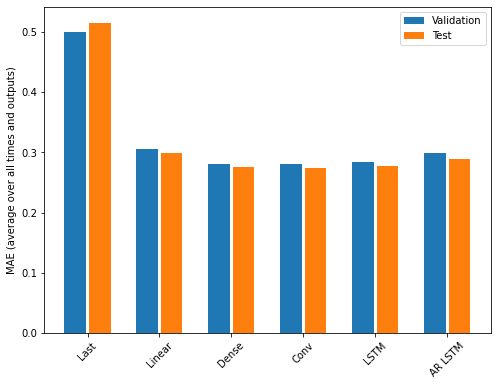

In [139]:
x = np.arange(len(multi_performance))
width = 0.3

metric_name = 'mean_absolute_error'
metric_index = lstm_model.metrics_names.index('mean_absolute_error')
val_mae = [v[metric_index] for v in multi_val_performance.values()]
test_mae = [v[metric_index] for v in multi_performance.values()]

plt.bar(x - 0.17, val_mae, width, label='Validation')
plt.bar(x + 0.17, test_mae, width, label='Test')
plt.xticks(ticks=x, labels=multi_performance.keys(),
           rotation=45)
plt.ylabel(f'MAE (average over all times and outputs)')
_ = plt.legend()

The metrics for the multi-output models in the first half of this tutorial show the performance averaged across all output features. These performances are similar but also averaged across output time steps. 

In [140]:
for name, value in multi_performance.items():
  print(f'{name:8s}: {value[1]:0.4f}')

Last    : 0.5157
Linear  : 0.2995
Dense   : 0.2752
Conv    : 0.2743
LSTM    : 0.2772
AR LSTM : 0.2894


The gains achieved going from a dense model to convolutional and recurrent models are only a few percent (if any), and the autoregressive model performed clearly worse. So these more complex approaches may not be worth while on **this** problem, but there was no way to know without trying, and these models could be helpful for **your** problem.

## Next steps

This tutorial was a quick introduction to time series forecasting using TensorFlow.

To learn more, refer to:

- Chapter 15 of <a href="https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/" class="external">Hands-on Machine Learning with Scikit-Learn, Keras, and TensorFlow</a>, 2nd Edition.
- Chapter 6 of <a href="https://www.manning.com/books/deep-learning-with-python" class="external">Deep Learning with Python</a>.
- Lesson 8 of <a href="https://www.udacity.com/course/intro-to-tensorflow-for-deep-learning--ud187" class="external">Udacity's intro to TensorFlow for deep learning</a>, including the <a href="https://github.com/tensorflow/examples/tree/master/courses/udacity_intro_to_tensorflow_for_deep_learning" class="external">exercise notebooks</a>.

Also, remember that you can implement any <a href="https://otexts.com/fpp2/index.html" class="external">classical time series model</a> in TensorFlow—this tutorial just focuses on TensorFlow's built-in functionality.
